# Library

In [1]:
import pandas as pd
import numpy as np
import sys
sys.path.append('../../../Util')
import BERTopicUtils as btu
import TextClustering as tc
from collections import Counter, defaultdict
import seaborn as sns
from wordcloud import WordCloud
import networkx as nx
import matplotlib.pyplot as plt
import squarify
from transformers import pipeline
from tqdm import tqdm
from bertopic import BERTopic
from sentence_transformers import SentenceTransformer, util
from bertopic.representation import MaximalMarginalRelevance, KeyBERTInspired, PartOfSpeech
from sklearn.feature_extraction.text import CountVectorizer
from keybert import KeyBERT
from umap import UMAP
import hdbscan
from sklearn.metrics import silhouette_score, calinski_harabasz_score, davies_bouldin_score
import csv
from bertopic.vectorizers import ClassTfidfTransformer
from sklearn.cluster import KMeans
from scipy.spatial import distance
from scipy.cluster import hierarchy as sch
from sklearn.cluster import AgglomerativeClustering
from matplotlib.colors import ListedColormap
from gensim.models.coherencemodel import CoherenceModel
from gensim import corpora
from itertools import combinations

c:\Users\dommy\miniconda3\envs\gestione\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


# 4° Approach: BERTopic

## Baseline Summary

### Clustering Approach

- **Parameter Setting**: A high parameter was set for HDBSCAN to ensure well-defined clusters that occupy a significant percentage of the total dataset. This baseline is intended to feed machine learning algorithms for prediction purposes.
  
### Initial Clustering Results

- **Clusters Retrieved**: 7 representative clusters were identified:
  1. **Drug sales**
  2. **Bitcoin**
  3. **Scammers and seller reviews**
  4. **Marketplace advertising**
  5. **Purchase reviews**
  6. **Drug purchases**
  7. **Orders**

- **Outliers**: Initially, 34k outliers were found out of a total of 66k records.

- **Performance Metrics**:
  - **Silhouette Score**: 0.64
  - **Davies-Bouldin Score**: 0.6

### Outlier Reduction

- **Cosine Measure on Embeddings**: By applying a cosine similarity measure with a 0.53 threshold, the number of outliers was reduced from 34k to 27k, reintroducing about 7k records.

- **Updated Performance Metrics**:
  - **Silhouette Score**: 0.51
  - **Davies-Bouldin Score**: 0.8

### Trade-off Analysis

- **Outlier Reintroduction**: Reintroducing the outliers found a balance that prevented significant cluster degradation while keeping clusters well separated and defined, as evidenced by the graphs.

- **Cluster Distribution**: The updated clusters are well-distributed:
  - **Maximum cluster size**: 23% of the total dataset
  - **Minimum cluster size**: 7% of the total dataset
  - This distribution avoids large excursions.

### Data Loss and Potential Adjustments

- **Data Loss**: Approximately 40% of the initial dataset was lost. 

- **Potential Correction**: This data loss can potentially be mitigated by lowering the cosine similarity threshold between embeddings.

##

In [4]:
df = btu.load_data_filtered('cleaned_data_name_thread.zip', 'name_thread')

66735


In [ ]:
model = SentenceTransformer('distiluse-base-multilingual-cased-v1')
tc1 = tc.TextClustering(df, 'name_thread')
tc1.encode_corpus(model, batch_size=64, to_tensor=False)

In [ ]:
seed_topic_list = [[
    'tor site', 'drug', 'cocaine', 'ketamine', 'weed', 'trafficking', 'scammer', 'market', 'vendor', 'bitcoin',
    'mdma', 'coke', 'lsd', 'heroine', 'xanax', 'tor node', 'tor site', 'gun', 'weapon', 'hacking'
]]

zeroshot_topic_list = [pd.read_csv('../../../Datasets/IntentCrime/intent_crime.csv')['intent'].tolist()]

representation_model = MaximalMarginalRelevance(diversity=0.3)
vectorizer_model = CountVectorizer(stop_words="english")
ctfidf_model = ClassTfidfTransformer(reduce_frequent_words=True)
umap_model = UMAP(n_neighbors=15, n_components=10, min_dist=0.0, metric='cosine', random_state=42)
hdbscan_model = hdbscan.HDBSCAN(min_cluster_size=1200, metric='euclidean', cluster_selection_method='eom', prediction_data=True)

topic_model = BERTopic(
    language='multilingual',
    top_n_words=10, 
    n_gram_range=(1, 2),
    umap_model=umap_model, 
    hdbscan_model=hdbscan_model, 
    seed_topic_list=seed_topic_list, 
    vectorizer_model=vectorizer_model, 
    ctfidf_model=ctfidf_model, 
    representation_model=representation_model,
    zeroshot_topic_list=zeroshot_topic_list, 
    zeroshot_min_similarity=.05, 
    verbose=True
)

topics, probs = topic_model.fit_transform(tc1.corpus, tc1.corpus_embeddings)

In [21]:
print(topic_model.get_topic_info())
for topic_id in set(topics):
    print(f"Topic {topic_id}:")
    print(topic_model.get_topic(topic_id))

   Topic  Count                               Name  \
0     -1  34449            -1_new_free_ticket_help   
1      0   7495          0_weed_xanax_cocaine_coke   
2      1   6093    1_market_dream_empire_nightmare   
3      2   5034     2_vendor_scammer_scam_scamming   
4      3   4087      3_review_vendor_feedback_mdma   
5      4   4003              4_mdma_lsd_shit_whats   
6      5   2402  5_order_package_delivery_shipping   
7      6   1966       6_bitcoin_card_wallet_credit   

                                      Representation  \
0  [new, free, ticket, help, update, account, mdm...   
1  [weed, xanax, cocaine, coke, ketamine, mg, can...   
2  [market, dream, empire, nightmare, vendor, wal...   
3  [vendor, scammer, scam, scamming, exit, scamme...   
4  [review, vendor, feedback, mdma, mg, sample, r...   
5  [mdma, lsd, shit, whats, fuck, gone, got, guy,...   
6  [order, package, delivery, shipping, tracking,...   
7  [bitcoin, card, wallet, credit, coin, carding,...   

        

In [22]:
umap_embeddings = topic_model.umap_model.fit_transform(tc1.corpus_embeddings)
indices = [index for index, topic in enumerate(topics) if topic != -1]
X=umap_embeddings[np.array(indices)]
labels = [topic for index, topic in enumerate(topics) if topic != -1]
silhouette_scores = silhouette_score(X, labels)
print(f"silhouette_score: {silhouette_scores}")
print(f"Davies_bouldin_score: {davies_bouldin_score(X, labels)}")

silhouette_score: 0.6388389468193054
Davies_bouldin_score: 0.5523262827209047


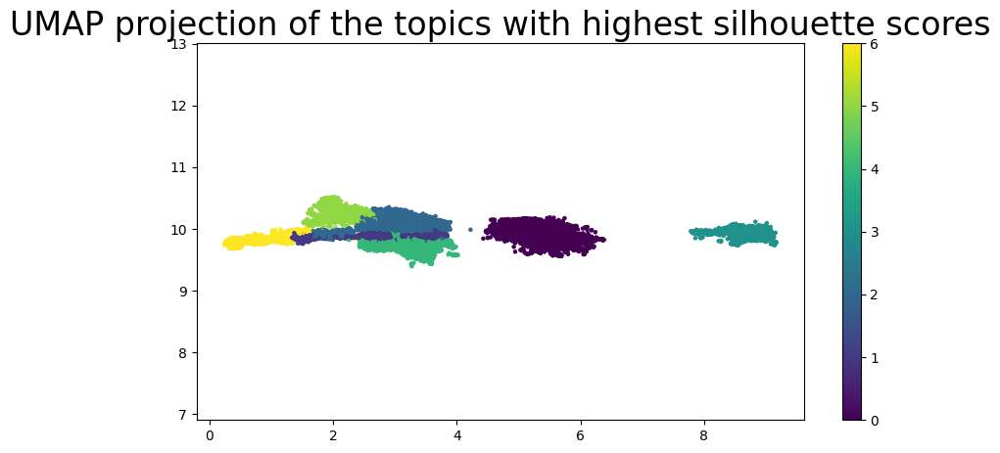

In [24]:
best_indices = np.argsort(silhouette_scores)[-10:]
best_umap_embeddings = umap_embeddings[best_indices]
plt.figure(figsize=(10, 5))
plt.scatter(X[:, 0], X[:, 1], c=labels, cmap='viridis', s=5)
plt.gca().set_aspect('equal', 'datalim')
plt.colorbar()
plt.title('UMAP projection of the topics with highest silhouette scores', fontsize=24)
plt.show()

In [25]:
vectorizer_model = CountVectorizer(stop_words="english", ngram_range=(1, 5))
topic_model.update_topics(tc1.corpus, vectorizer_model=vectorizer_model)

In [26]:
topic_model.get_topic_freq()

,Topic,Count
0,-1,34449
5,0,7495
2,1,6093
1,2,5034
7,3,4087
6,4,4003
3,5,2402
4,6,1966


In [27]:
print(topic_model.get_topic_info())
for topic_id in set(topics):
    print(f"Topic {topic_id}:")
    print(topic_model.get_topic(topic_id))

   Topic  Count                                         Name  \
0     -1  34449                      -1_vendor_new_free_help   
1      0   7495                       0_weed_vendor_xanax_mg   
2      1   6093                 1_market_empire_dream_vendor   
3      2   5034                2_vendor_scammer_scam_looking   
4      3   4087  3_review_vendor review_vendor_review vendor   
5      4   4003                          4_mdma_lsd_good_got   
6      5   2402            5_order_package_shipping_delivery   
7      6   1966                 6_card_bitcoin_wallet_credit   

                                      Representation  \
0  [vendor, new, free, help, best, account, uk, u...   
1  [weed, vendor, xanax, mg, cocaine, uk, best, c...   
2  [market, empire, dream, vendor, nightmare, dre...   
3  [vendor, scammer, scam, looking, scamming, exi...   
4  [review, vendor review, vendor, review vendor,...   
5  [mdma, lsd, good, got, shit, whats, guy, fuck,...   
6  [order, package, shipping, d

In [28]:
topic_model.visualize_topics()

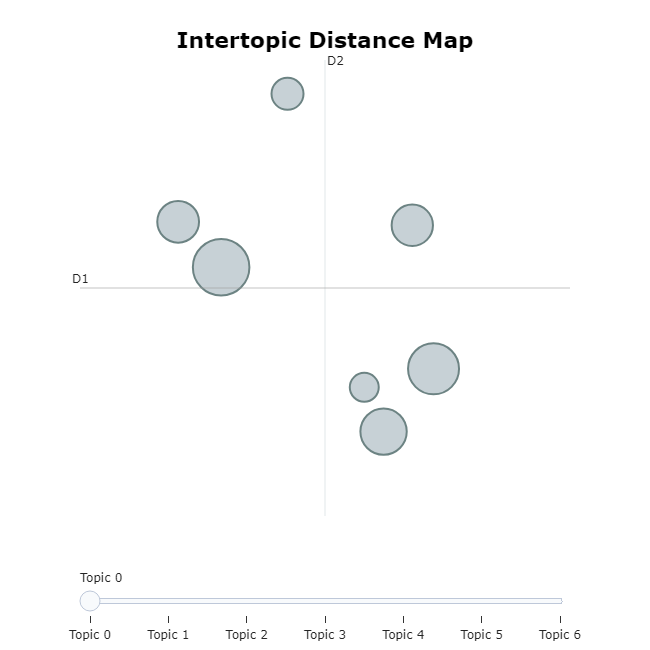

In [29]:
topic_model.visualize_heatmap()

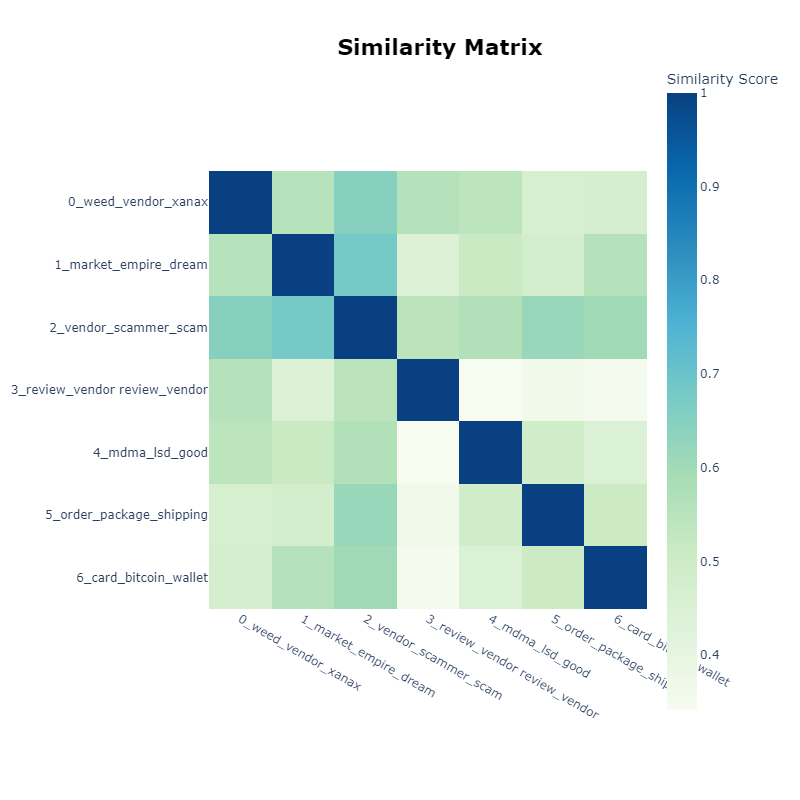

In [30]:
topic_model.visualize_hierarchy()

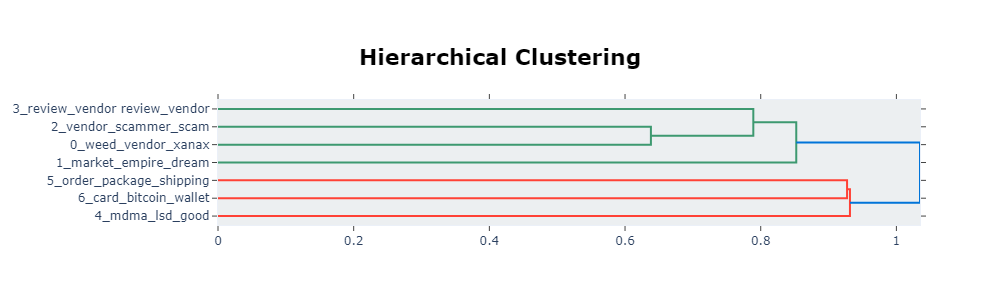

In [31]:
reduced_embeddings = UMAP(n_neighbors=15, n_components=2, 
                          min_dist=0.0, metric='cosine').fit_transform(tc1.corpus_embeddings)
topic_model.visualize_documents(tc1.corpus, reduced_embeddings=reduced_embeddings, 
                                hide_document_hover=True, hide_annotations=True)

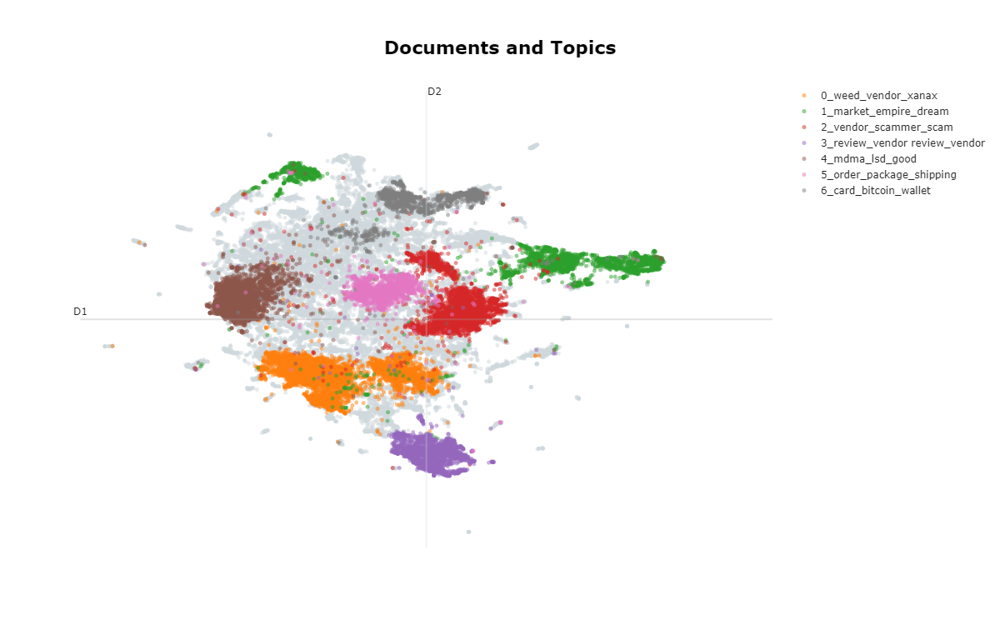

In [32]:
topic_model.visualize_barchart()

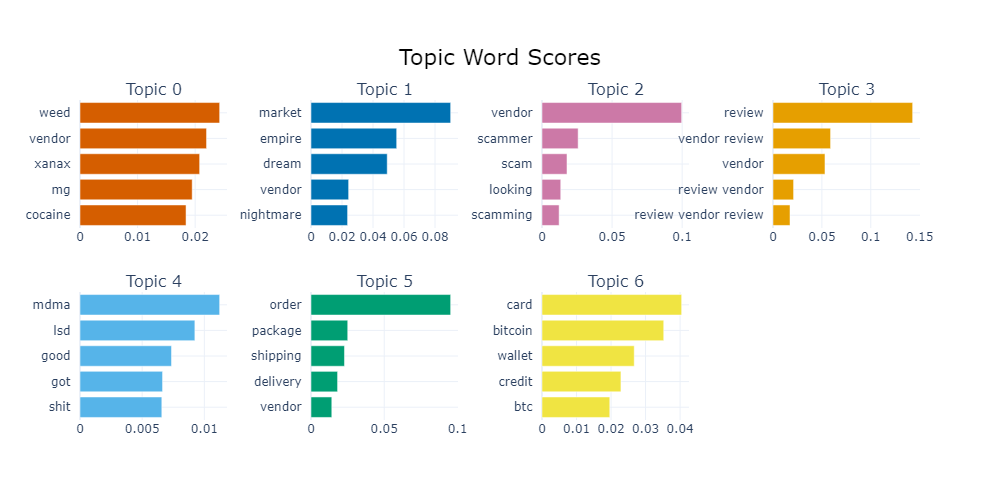

In [ ]:
new_topics = topic_model.reduce_outliers(tc1.corpus, topics, strategy="embeddings", embeddings=tc1.corpus_embeddings, threshold=0.53)
topic_model.update_topics(tc1.corpus, topics=new_topics)

In [75]:
topic_model.get_topic_info()

,Topic,Count,Name,Representation,Representative_Docs
0,-1,27613,-1_anyone_new_help_free,"[anyone, new, help, free, please, update, tick...",[canadianflavor weed shatter cbd edible hash c...
1,0,8645,0_weed_xanax_vendor_cocaine,"[weed, xanax, vendor, cocaine, mg, uk, coke, b...","[high quality weed thc product europe, new xan..."
2,1,6236,1_market_empire_dream_nightmare,"[market, empire, dream, nightmare, vendor, dre...","[next market, dream market vendor rstclass nig..."
3,2,6907,2_vendor_scammer_scam_looking,"[vendor, scammer, scam, looking, scamming, sal...","[looking good reliable vendor sell ounce, vend..."
4,3,4230,3_review_vendor review_vendor_review vendor,"[review, vendor review, vendor, review vendor,...","[empire vendor cocaine review, first ever revi..."
5,4,6299,4_mdma_lsd_get_looking,"[mdma, lsd, get, looking, wsm, good, btc, ques...","[hey ro im gon na pull pk, life wonderful life..."
6,5,2776,5_order_package_shipping_delivery,"[order, package, shipping, delivery, pack, shi...",[order accepted day still hasnt marked shipped...
7,6,2823,6_bitcoin_card_wallet_btc,"[bitcoin, card, wallet, btc, bank, credit, car...","[credit cards paypal prepaid card find, got cc..."


In [76]:
topic_model.visualize_documents(tc1.corpus, reduced_embeddings=reduced_embeddings, 
                                hide_document_hover=True, hide_annotations=True)

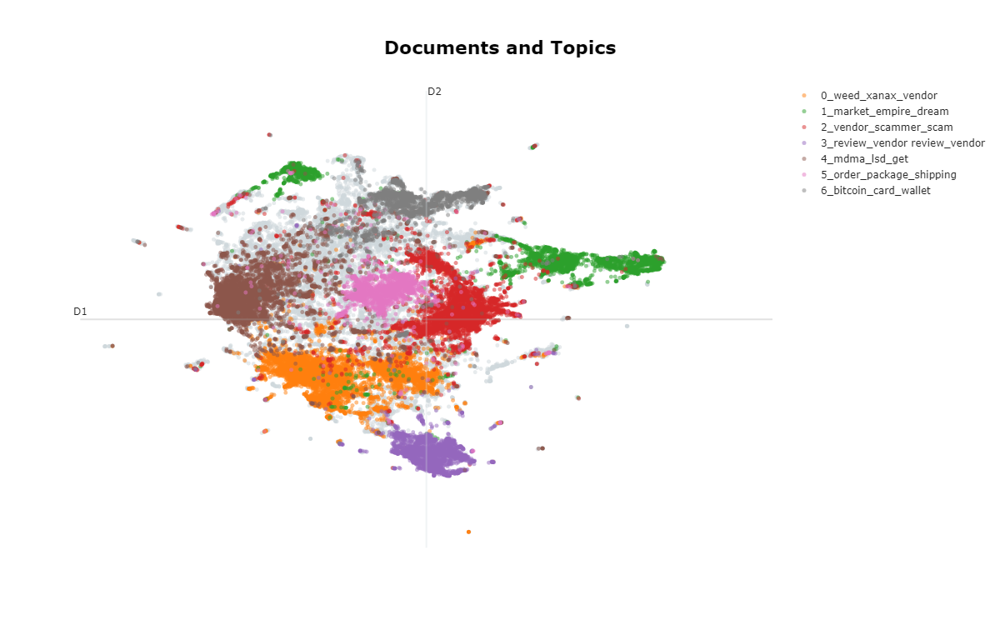

In [77]:
topic_model.visualize_hierarchy()

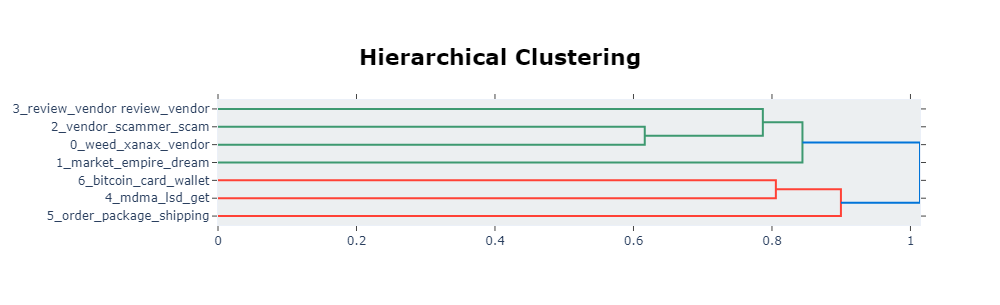

In [78]:
topic_model.visualize_topics()

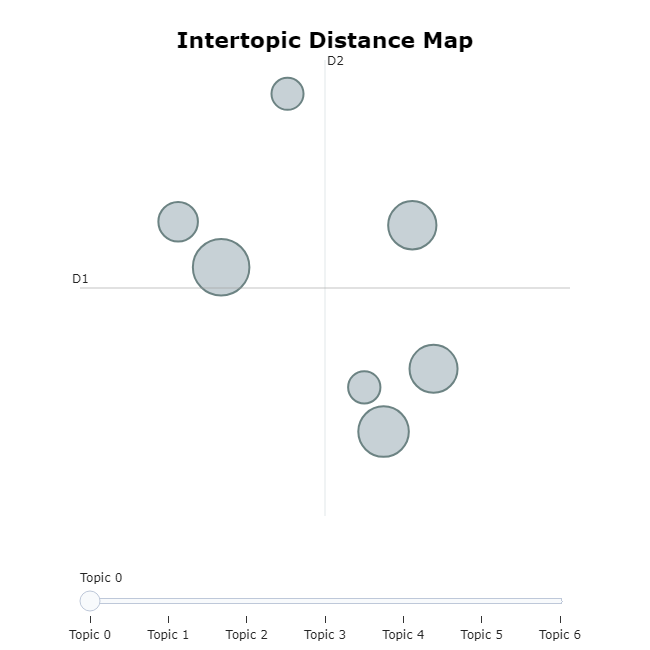

In [88]:
topic_model.visualize_barchart()

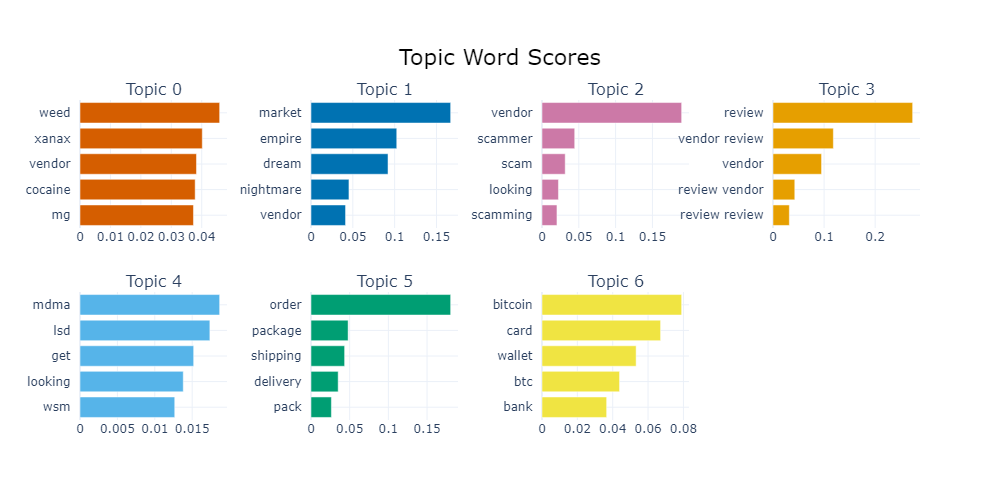

In [79]:
silhouette_scores, davies_bouldin_scores, X = btu.calculate_silhouette_davies(umap_embeddings, new_topics)

silhouette_score: 0.5083789229393005
Davies_bouldin_score: 0.7570962651091117


In [30]:
coherence_model = btu.evaluate_topic_coherence(topic_model.get_topics(), tc1.corpus)

Coherence Model: 0.40058884901572617


In [ ]:
df['name_thread'] = df['name_thread'].str.lower().dropna()
df.drop_duplicates(subset='name_thread', inplace=True)
df.dropna(subset=['name_thread'], inplace=True)
created_on = df['created_on'].tolist()
len(created_on)

In [ ]:
topics_over_time = topic_model.topics_over_time(tc1.corpus, created_on, 
                                                global_tuning=True, evolution_tuning=True, nr_bins=100)

In [82]:
topic_model.visualize_topics_over_time(topics_over_time, width=1250, height=700)

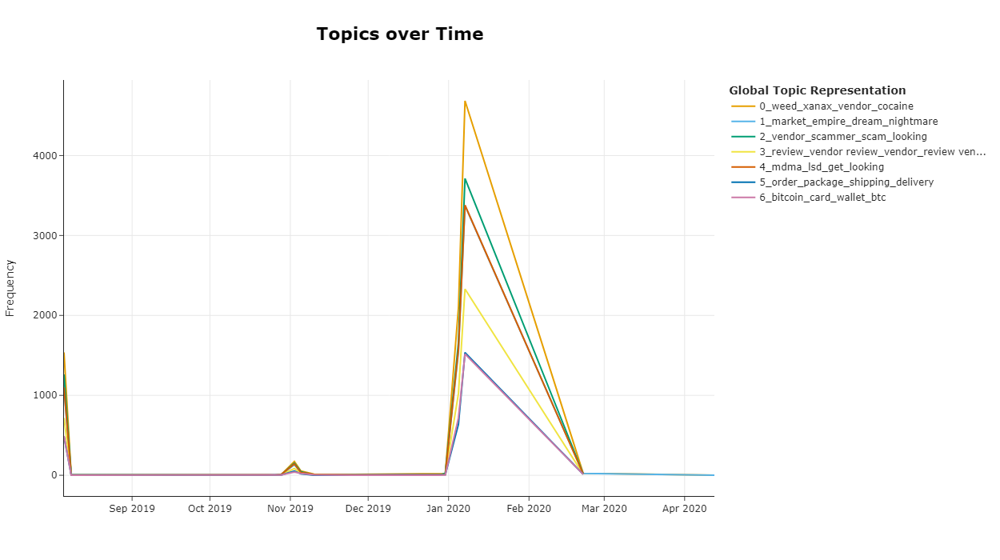

In [83]:
results_final = btu.return_dataset(tc1.corpus, created_on, tc1.corpus_embeddings, new_topics, probs, topic_model, umap_embeddings)
print(results_final.shape)
results_final.head()

(37916, 10)


,Document,Embedding,Topic,Probability,Created_on,Count,Name,Representation,Representative_Docs,UMAP_embedding
0,checks,"[0.052164897, 0.029597273, -0.03666609, 0.0051...",4,0.000000,2020-01-09,6299,4_mdma_lsd_get_looking,"[mdma, lsd, get, looking, wsm, good, btc, ques...","[hey ro im gon na pull pk, life wonderful life...","[1.6488198, 9.914265, 1.442794, 2.8094368, -0...."
1,trusted vendor status,"[0.02445144, -0.008732641, -0.0050215074, 0.01...",2,0.944247,2020-01-09,6907,2_vendor_scammer_scam_looking,"[vendor, scammer, scam, looking, scamming, sal...","[looking good reliable vendor sell ounce, vend...","[2.910516, 10.281041, 1.650234, 3.0320778, -0...."
2,empire exit scam iiflux user incomming,"[0.02890829, 0.036081452, -0.027694924, -0.007...",1,1.000000,2019-11-06,6236,1_market_empire_dream_nightmare,"[market, empire, dream, nightmare, vendor, dre...","[next market, dream market vendor rstclass nig...","[1.5884036, 9.8587885, 3.3090453, 2.652358, 2...."
3,ecstasy vendor packs,"[-0.022524439, 0.03949761, -0.023750877, 0.033...",5,0.797741,2020-01-09,2776,5_order_package_shipping_delivery,"[order, package, shipping, delivery, pack, shi...",[order accepted day still hasnt marked shipped...,"[2.0245404, 10.517631, 2.3443217, 3.7595236, -..."
4,opening bank account person fake id,"[-0.029834118, 0.03354508, -0.012210185, -0.02...",6,1.000000,2019-11-06,2823,6_bitcoin_card_wallet_btc,"[bitcoin, card, wallet, btc, bank, credit, car...","[credit cards paypal prepaid card find, got cc...","[0.7278271, 9.884823, 1.8116106, 2.9336705, -0..."


In [ ]:
topic_model.save("Models/topic_model_0.64SilNew", serialization='pickle')

In [11]:
topic_model.save("Models/topic_model_0.64SilNew_safetensors", serialization="safetensors", save_ctfidf=True, save_embedding_model=model)

In [85]:
results_final.to_parquet('DatasetsThreadBERTopic/BERTopic_nodefinedcluster_topics_15n_10com_1200cluster_0.64sil_renewout.parquet')

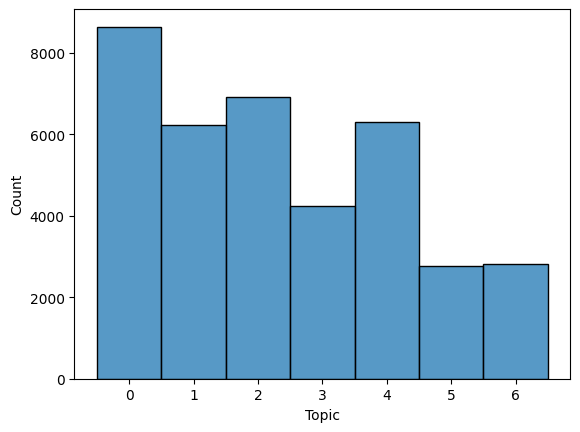

In [86]:
sns.histplot(results_final, x='Topic', discrete=True);

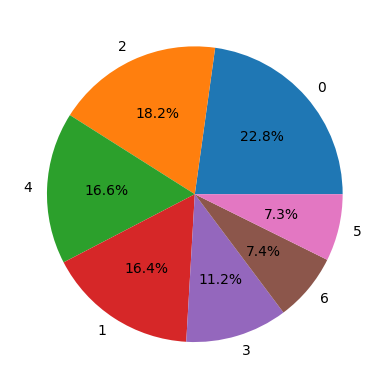

In [87]:
plt.pie(results_final.value_counts('Topic'), labels=results_final.value_counts('Topic').index, autopct='%1.1f%%');

## 500 min cluster size

In [12]:
model = SentenceTransformer('distiluse-base-multilingual-cased-v1')

In [ ]:
seed_topic_list = [[
    'tor site', 'drug', 'cocaine', 'ketamine', 'weed', 'trafficking', 'scammer', 'market', 'vendor', 'bitcoin',
    'mdma', 'coke', 'lsd', 'heroine', 'xanax', 'tor node', 'tor site', 'gun', 'weapon', 'hacking'
]]

zeroshot_topic_list = [pd.read_csv('../../../Datasets/IntentCrime/intent_crime.csv')['intent'].tolist()]

representation_model = MaximalMarginalRelevance(diversity=0.3)
vectorizer_model = CountVectorizer(stop_words="english")
ctfidf_model = ClassTfidfTransformer(reduce_frequent_words=True)
umap_model = UMAP(n_neighbors=15, n_components=10, min_dist=0.0, metric='cosine', random_state=42)
hdbscan_model = hdbscan.HDBSCAN(min_cluster_size=500, metric='euclidean', cluster_selection_method='eom', prediction_data=True)

topic_model = BERTopic(
    language='multilingual',
    top_n_words=10, 
    n_gram_range=(1, 2),
    umap_model=umap_model, 
    hdbscan_model=hdbscan_model, 
    seed_topic_list=seed_topic_list, 
    vectorizer_model=vectorizer_model, 
    ctfidf_model=ctfidf_model, 
    representation_model=representation_model,
    zeroshot_topic_list=zeroshot_topic_list, 
    zeroshot_min_similarity=.05, 
    verbose=True
)

topics, probs = topic_model.fit_transform(tc1.corpus, tc1.corpus_embeddings)

In [59]:
topic_model.get_topic_info()

,Topic,Count,Name,Representation,Representative_Docs
0,-1,28000,-1_mdma_new_link_lsd,"[mdma, new, link, lsd, help, free, vendor, nee...","[need high quality fake id check , big thanks ..."
1,0,4930,0_xanax_coke_cocaine_ketamine,"[xanax, coke, cocaine, ketamine, mg, drug, pil...",[promo sale mg adderall ad xanax mg lsd mdma u...
2,1,4469,1_bitcoin_card_bank_carding,"[bitcoin, card, bank, carding, monero, wallet,...","[way cash bank log using btc, send bitcoin get..."
3,2,4227,2_dread_sub_lsd_shit,"[dread, sub, lsd, shit, mdma, whats, guy, fuck...","[hey guy xangod man, let guy know dread host w..."
4,3,3702,3_market_dream_nightmare_dreammarket,"[market, dream, nightmare, dreammarket, market...","[not order nightmare market, nightmare market ..."
5,4,3469,4_review_vendor_reviews_mg,"[review, vendor, reviews, mg, vendymcvendface,...","[thclear ml purple kush vape cart review, vend..."
6,5,3410,5_order_package_pack_dispute,"[order, package, pack, dispute, delivery, ship...","[package custom month love letter nothing, pac..."
7,6,2700,6_vendor_looking_seller_vendors,"[vendor, looking, seller, vendors, buyer, lsd,...","[best vendor uk lsd, looking good vendor cc fu..."
8,7,1694,7_weed_cannabis_marijuana_hash,"[weed, cannabis, marijuana, hash, quality, str...","[hash weed ship eu good vendor also usa, new i..."
9,8,1540,8_darknet_dark_web_sentenced,"[darknet, dark, web, sentenced, drug, darkweb,...",[tacoma man sentenced four year dealing drugs ...


In [60]:
umap_embeddings = topic_model.umap_model.fit_transform(tc1.corpus_embeddings)
indices = [index for index, topic in enumerate(topics) if topic != -1]
X=umap_embeddings[np.array(indices)]
labels = [topic for index, topic in enumerate(topics) if topic != -1]
silhouette_scores = silhouette_score(X, labels)
print(f"silhouette_score: {silhouette_scores}")
print(f"Davies_bouldin_score: {davies_bouldin_score(X, labels)}")

silhouette_score: 0.5718363523483276
Davies_bouldin_score: 0.6211900149809264


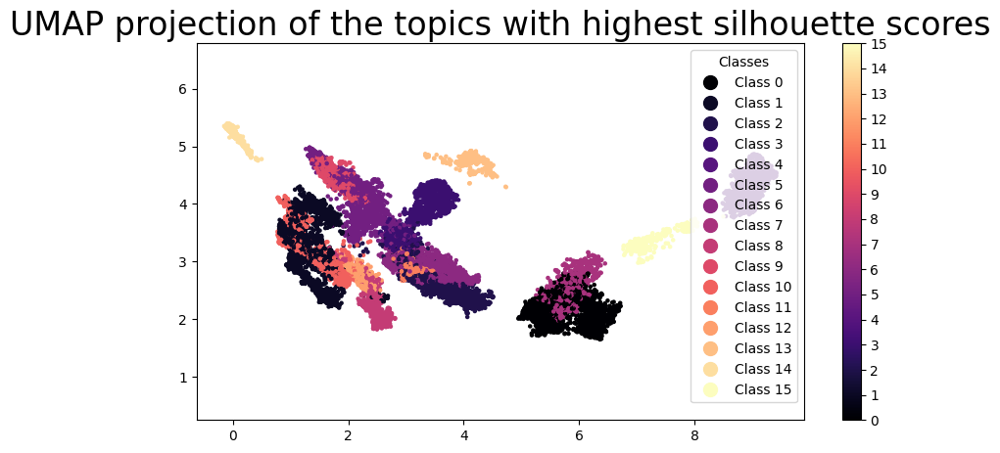

In [61]:
best_indices = np.argsort(silhouette_scores)[-10:]
best_umap_embeddings = umap_embeddings[best_indices]
unique_labels = np.unique(labels)
cmap = plt.cm.magma
plt.figure(figsize=(10, 5))
scatter = plt.scatter(X[:, 1], X[:, 2], c=labels, cmap=cmap, s=5)
plt.gca().set_aspect('equal', 'datalim')
norm = plt.Normalize(vmin=min(labels), vmax=max(labels))
handles = [plt.Line2D([0], [0], marker='o', color=cmap(norm(label)), linestyle='', markersize=10) for label in unique_labels]
legend_labels = [f'Class {label}' for label in unique_labels]
plt.legend(handles, legend_labels, title="Classes")
plt.colorbar(scatter, ticks=range(len(unique_labels)))
plt.title('UMAP projection of the topics with highest silhouette scores', fontsize=24)
plt.show()

In [62]:
vectorizer_model = CountVectorizer(stop_words="english", ngram_range=(1, 5))
topic_model.update_topics(tc1.corpus, vectorizer_model=vectorizer_model)

In [63]:
topic_model.visualize_topics()

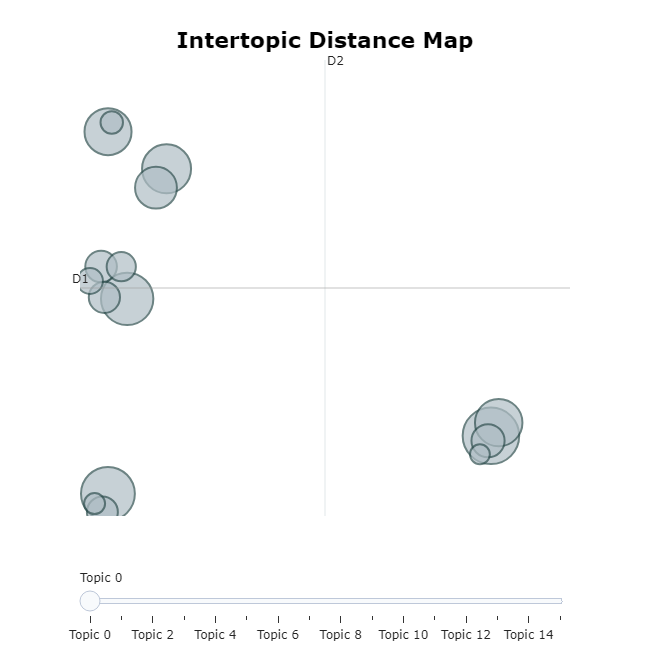

In [64]:
topic_model.visualize_heatmap()

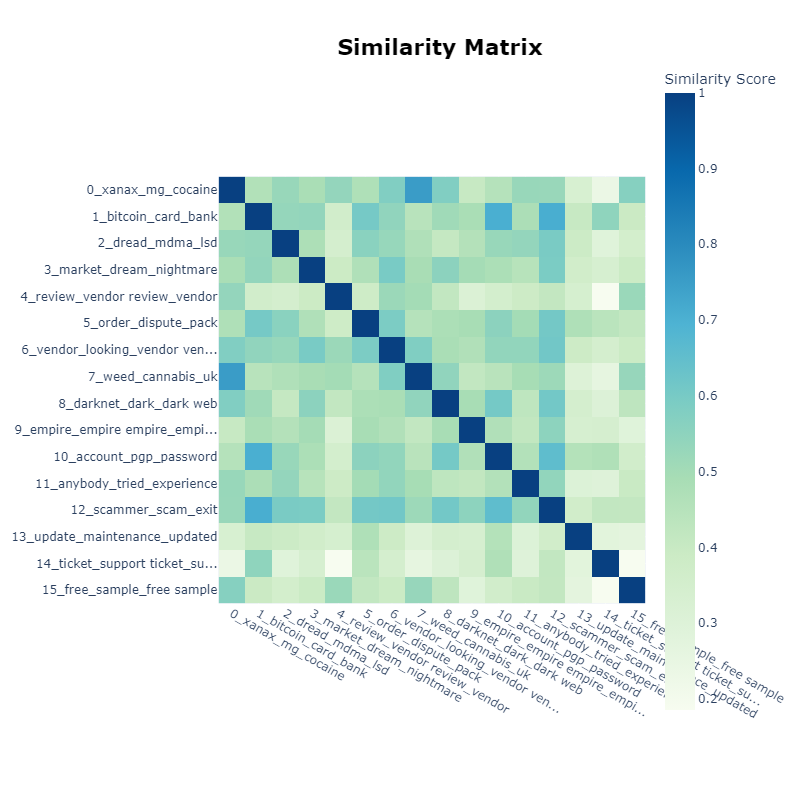

In [65]:
topic_model.visualize_hierarchy()

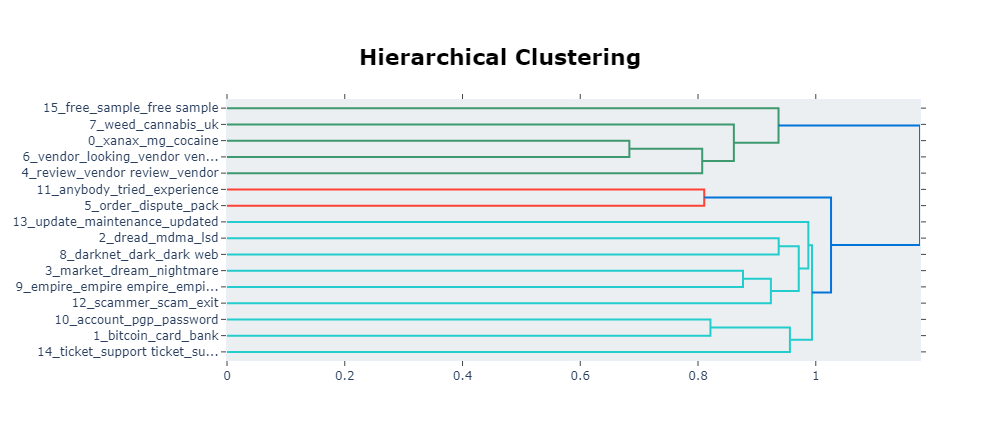

In [66]:
reduced_embeddings = UMAP(n_neighbors=15, n_components=2, 
                          min_dist=0.0, metric='cosine').fit_transform(tc1.corpus_embeddings)
topic_model.visualize_documents(tc1.corpus, reduced_embeddings=reduced_embeddings, 
                                hide_document_hover=True, hide_annotations=True)

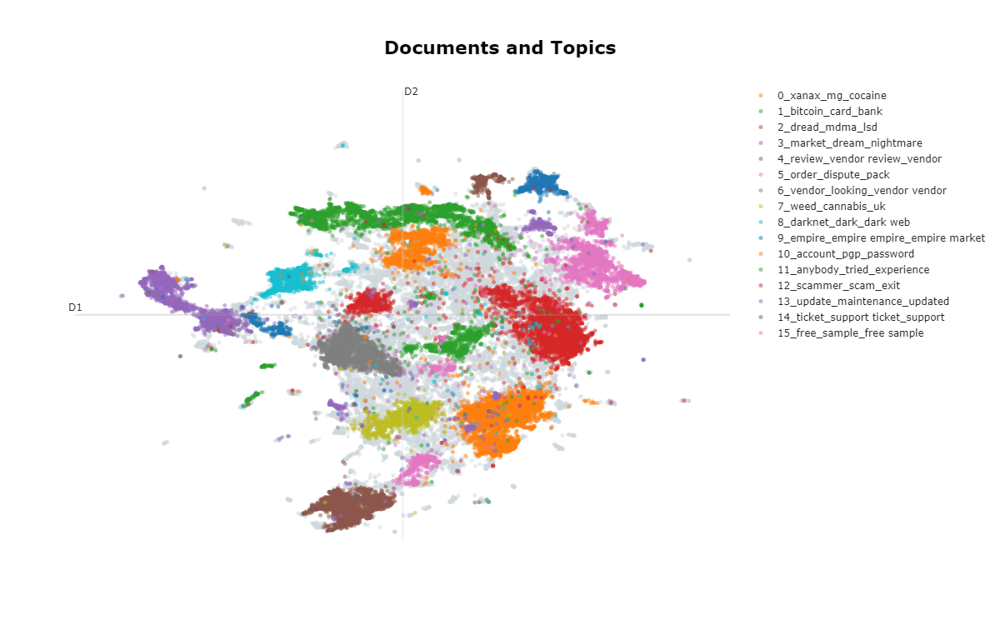

In [ ]:
new_topics = topic_model.reduce_outliers(tc1.corpus, topics, strategy="embeddings", embeddings=tc1.corpus_embeddings, threshold=0.6)
topic_model.update_topics(tc1.corpus, topics=new_topics)

In [96]:
topic_model.get_topic_info()

,Topic,Count,Name,Representation,Representative_Docs
0,-1,23928,-1_new_vendor_help_uk,"[new, vendor, help, uk, need, mdma, best, free...","[need high quality fake id check , big thanks ..."
1,0,5207,0_xanax_cocaine_mg_coke,"[xanax, cocaine, mg, coke, ketamine, vendor, p...",[promo sale mg adderall ad xanax mg lsd mdma u...
2,1,4512,1_bitcoin_card_bank_carding,"[bitcoin, card, bank, carding, monero, wallet,...","[way cash bank log using btc, send bitcoin get..."
3,2,4944,2_dread_mdma_lsd_get,"[dread, mdma, lsd, get, sub, shit, guy, lookin...","[hey guy xangod man, let guy know dread host w..."
4,3,3801,3_market_dream_nightmare_dream market,"[market, dream, nightmare, dream market, vendo...","[not order nightmare market, nightmare market ..."
5,4,3706,4_review_vendor review_vendor_review vendor,"[review, vendor review, vendor, review vendor,...","[thclear ml purple kush vape cart review, vend..."
6,5,3434,5_order_dispute_pack_package,"[order, dispute, pack, package, shipping, deli...","[package custom month love letter nothing, pac..."
7,6,4123,6_vendor_vendor vendor_looking_best,"[vendor, vendor vendor, looking, best, inquiry...","[best vendor uk lsd, looking good vendor cc fu..."
8,7,1848,7_weed_cannabis_uk_weed vendor,"[weed, cannabis, uk, weed vendor, vendor, qual...","[hash weed ship eu good vendor also usa, new i..."
9,8,1557,8_darknet_dark_dark web_web,"[darknet, dark, dark web, web, drug, sentenced...",[tacoma man sentenced four year dealing drugs ...


In [97]:
topic_model.visualize_documents(tc1.corpus, reduced_embeddings=reduced_embeddings, 
                                hide_document_hover=True, hide_annotations=True)

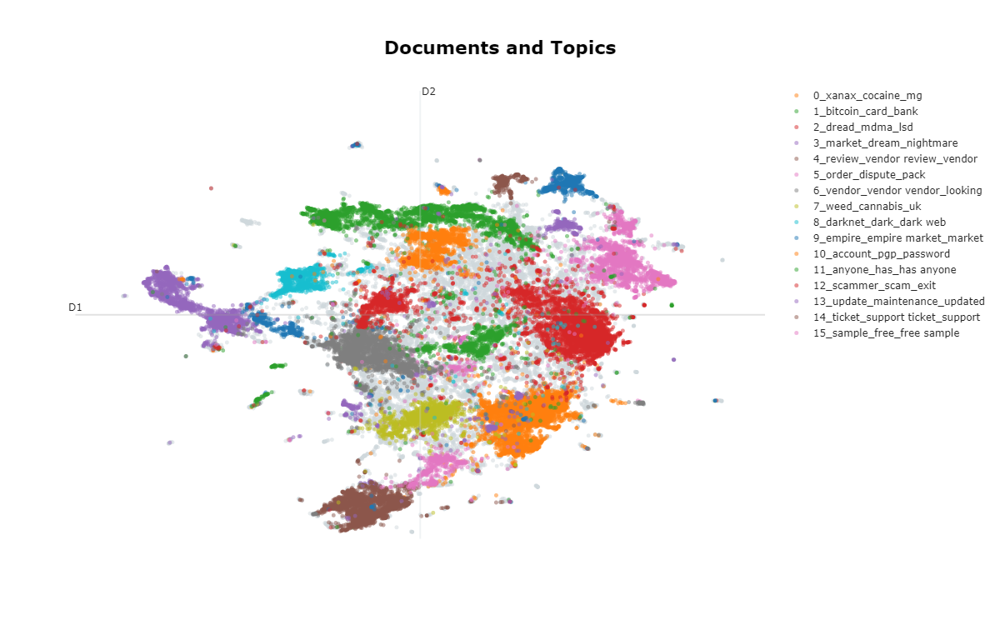

In [98]:
topic_model.visualize_topics()

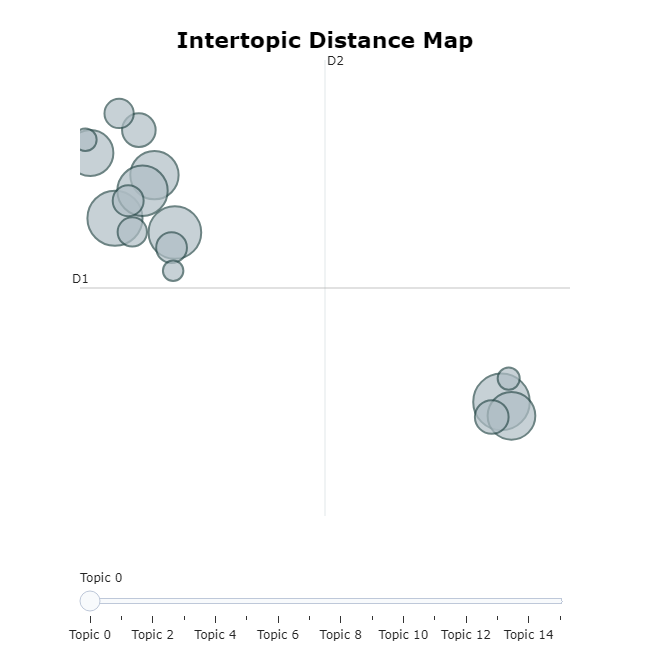

In [106]:
topic_model.visualize_hierarchy()

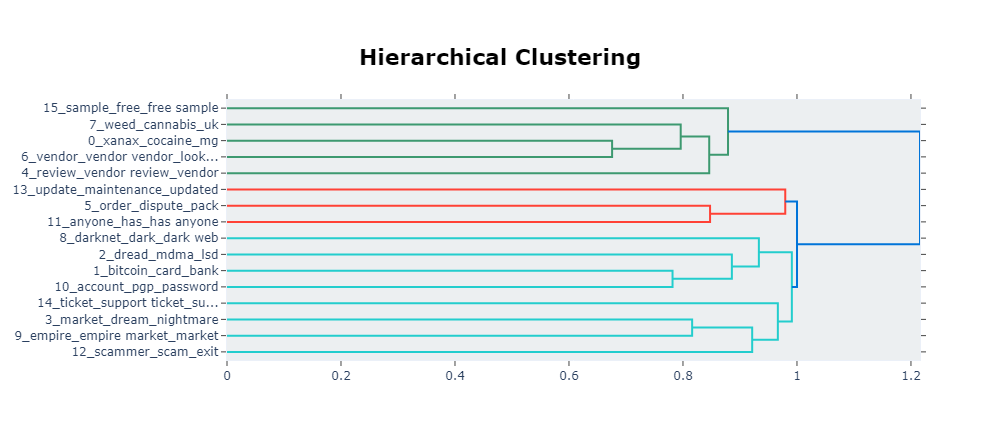

In [15]:
topic_model.visualize_barchart(top_n_topics=16)

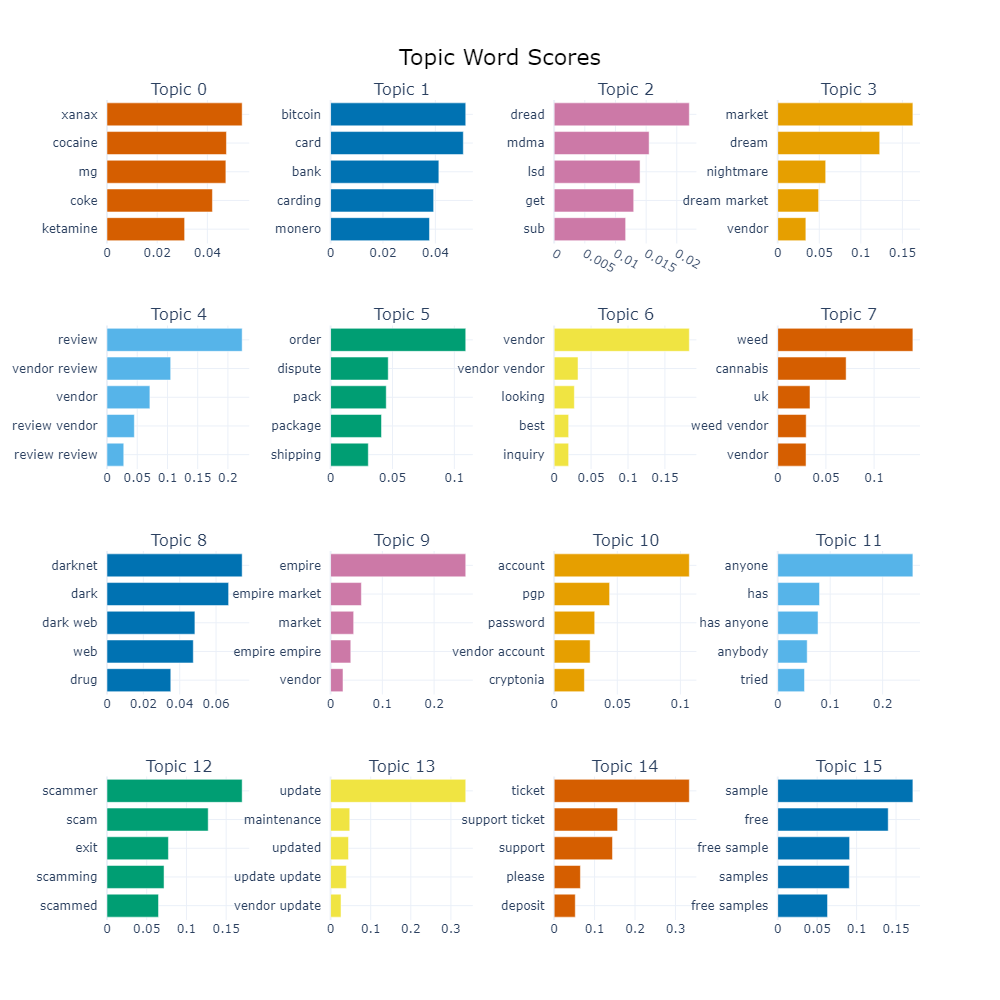

In [99]:
silhouette_scores, davies_bouldin_scores, X = btu.calculate_silhouette_davies(umap_embeddings, new_topics)

silhouette_score: 0.49986162781715393
Davies_bouldin_score: 0.7193546666619981


In [28]:
coherence_model = btu.evaluate_topic_coherence(topic_model.get_topics(), tc1.corpus)

Coherence Model: 0.4902822303421074


In [100]:
results_final = btu.return_dataset(tc1.corpus, created_on, tc1.corpus_embeddings, new_topics, probs, topic_model, umap_embeddings)
print(results_final.shape)
results_final.head()

(41601, 10)


In [ ]:
topics_over_time = topic_model.topics_over_time(tc1.corpus, created_on, 
                                                global_tuning=True, evolution_tuning=True, nr_bins=100)
topic_model.visualize_topics_over_time(topics_over_time, width=1250, height=700)

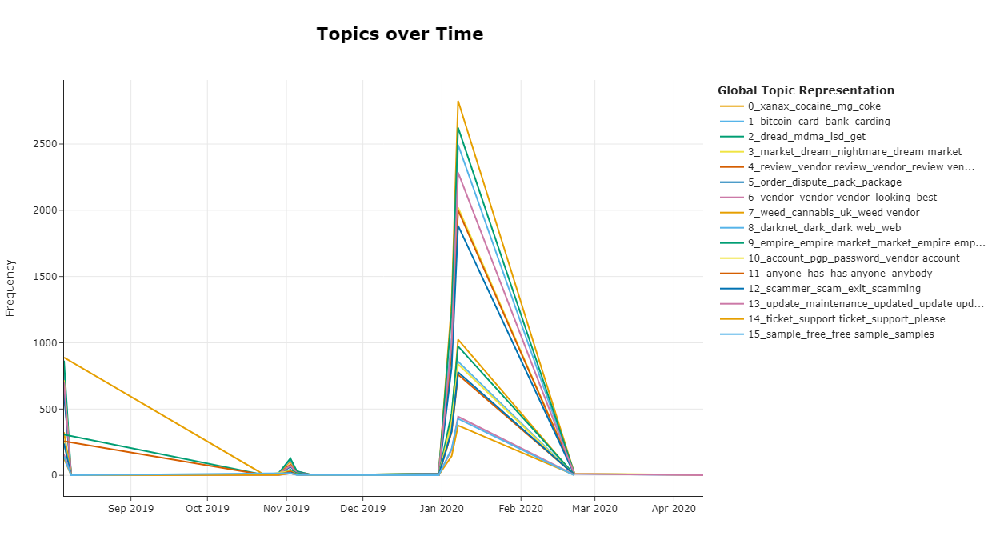

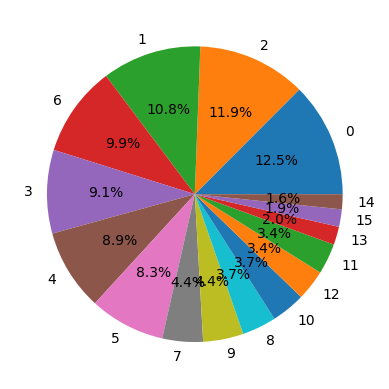

In [107]:
plt.pie(results_final.value_counts('Topic'), labels=results_final.value_counts('Topic').index, autopct='%1.1f%%');

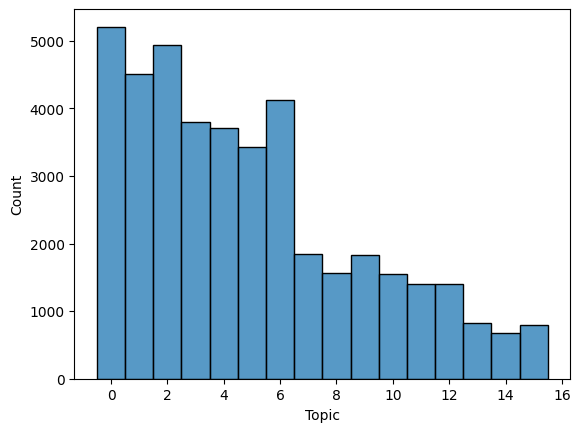

In [108]:
sns.histplot(results_final, x='Topic', discrete=True);

In [ ]:
topic_model.save("Models/topic_model_0.50Sil300", serialization='pickle')

In [14]:
topic_model.save("Models/topic_model_0.50Sil300_safetensors", serialization="safetensors", save_ctfidf=True, save_embedding_model=model)

## 400 all-MiniLM-L6-v2

In [9]:
df = btu.load_data_filtered('cleaned_data_name_thread.zip', 'name_thread')

66735


In [10]:
model = SentenceTransformer('all-MiniLM-L6-v2')
tc1 = tc.TextClustering(df, 'name_thread')
tc1.encode_corpus(model, batch_size=64, to_tensor=False)

2024-07-04 22:13:20,879 - TextClustering - INFO - Encoding the corpus. This might take a while.
Batches: 100%|██████████| 1024/1024 [06:44<00:00,  2.53it/s]


array([[-0.0569037 , -0.0207047 , -0.02773129, ..., -0.07344123,
        -0.03116781,  0.13771622],
       [-0.10284537, -0.02996513, -0.09226514, ..., -0.0646123 ,
         0.07471246, -0.05024509],
       [ 0.03057198,  0.01732188, -0.01216232, ..., -0.03779604,
        -0.04624576,  0.04093523],
       ...,
       [ 0.03594159,  0.04977278,  0.01365115, ..., -0.12596796,
        -0.09063663,  0.04086255],
       [-0.07082801, -0.05046489,  0.04210068, ..., -0.09733649,
        -0.00490899,  0.01999515],
       [-0.07523841,  0.03741602, -0.04537886, ...,  0.02108059,
         0.00612842, -0.00397777]], dtype=float32)

In [ ]:
mmr = MaximalMarginalRelevance(diversity=0.3)
kw = KeyBERTInspired()
vectorizer_model = CountVectorizer(stop_words="english")
ctfidf_model = ClassTfidfTransformer(reduce_frequent_words=True)
umap_model = UMAP(n_neighbors=15, n_components=10, min_dist=0.0, metric='cosine', random_state=42)
hdbscan_model = hdbscan.HDBSCAN(min_cluster_size=400, metric='euclidean', cluster_selection_method='eom', prediction_data=True)

topic_model = BERTopic(
    top_n_words=10, 
    n_gram_range=(1, 2),
    umap_model=umap_model, 
    hdbscan_model=hdbscan_model,
    vectorizer_model=vectorizer_model, 
    ctfidf_model=ctfidf_model, 
    representation_model=[mmr, kw],
    embedding_model=model,
    verbose=True
)

topics, probs = topic_model.fit_transform(tc1.corpus, tc1.corpus_embeddings)

In [23]:
print(topic_model.get_topic_info())
for topic_id in set(topics):
    print(f"Topic {topic_id}:")
    print(topic_model.get_topic(topic_id))

    Topic  Count                                               Name  \
0      -1  30941                         -1_customer_buy_sale_buyer   
1       0   5117                     0_vape_shatter_carts_cartridge   
2       1   2643                      1_login_password_logged_error   
3       2   2579                2_coca_opium_cocain_cocacolacompany   
4       3   2124               3_xanaxlabs_xanaxlife_xanax_xanaxusa   
5       4   1938                     4_postal_usps_delivery_postage   
6       5   1842     5_darkweb_darknetlive_darknetmarkets_sentenced   
7       6   1721      6_empire_empiremarket_empireteam_empiredealer   
8       7   1631                 7_mdma_mdmamaster_pill_ecstasydata   
9       8   1601               8_giftcard_card_giftcards_mastercard   
10      9   1502              9_vendor_vendorpro_vendors_vendorbbmc   
11     10   1417                  10_scamming_scammer_scam_scammers   
12     11   1126      11_counterfeiting_passport_counterfeit_fakeid   
13    

In [24]:
topic_model.get_topic_info()

,Topic,Count,Name,Representation,Representative_Docs
0,-1,30941,-1_customer_buy_sale_buyer,"[customer, buy, sale, buyer, service, message,...",[dutchdrugz updates promo active till market p...
1,0,5117,0_vape_shatter_carts_cartridge,"[vape, shatter, carts, cartridge, ounce, marij...",[sale girl scout cookie carts strains oz lb us...
2,1,2643,1_login_password_logged_error,"[login, password, logged, error, problem, log,...","[hey really could use help advice thanks, erro..."
3,2,2579,2_coca_opium_cocain_cocacolacompany,"[coca, opium, cocain, cocacolacompany, coke, c...",[colombian coke brazil ship world wide promoti...
4,3,2124,3_xanaxlabs_xanaxlife_xanax_xanaxusa,"[xanaxlabs, xanaxlife, xanax, xanaxusa, xanaxr...","[adderall mg ir adderall mg xanax super sale, ..."
5,4,1938,4_postal_usps_delivery_postage,"[postal, usps, delivery, postage, mail, delive...","[informed delivery showing package, usa canada..."
6,5,1842,5_darkweb_darknetlive_darknetmarkets_sentenced,"[darkweb, darknetlive, darknetmarkets, sentenc...",[three student arrested dark web drug traffick...
7,6,1721,6_empire_empiremarket_empireteam_empiredealer,"[empire, empiremarket, empireteam, empiredeale...","[empire anyone else, empire market back, empir..."
8,7,1631,7_mdma_mdmamaster_pill_ecstasydata,"[mdma, mdmamaster, pill, ecstasydata, mdmaus, ...","[sale xtc pill mg mda us ca, uk mdma pill vend..."
9,8,1601,8_giftcard_card_giftcards_mastercard,"[giftcard, card, giftcards, mastercard, cards,...","[carding amazon gift card, gift card prepaid d..."


In [25]:
umap_embeddings = topic_model.umap_model.fit_transform(tc1.corpus_embeddings)
silhouette_scores, davies_bouldin_scores, X = btu.calculate_silhouette_davies(umap_embeddings, topics)

silhouette_score: 0.6434006690979004
Davies_bouldin_score: 0.4681034572960446


In [26]:
vectorizer_model = CountVectorizer(stop_words="english", ngram_range=(1, 5))
topic_model.update_topics(tc1.corpus, vectorizer_model=vectorizer_model)

In [27]:
topic_model.visualize_topics()

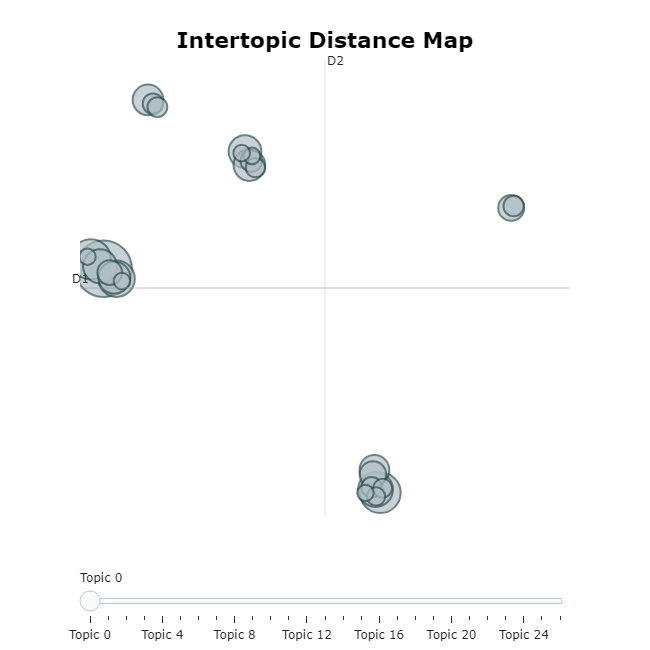

In [28]:
topic_model.visualize_heatmap()

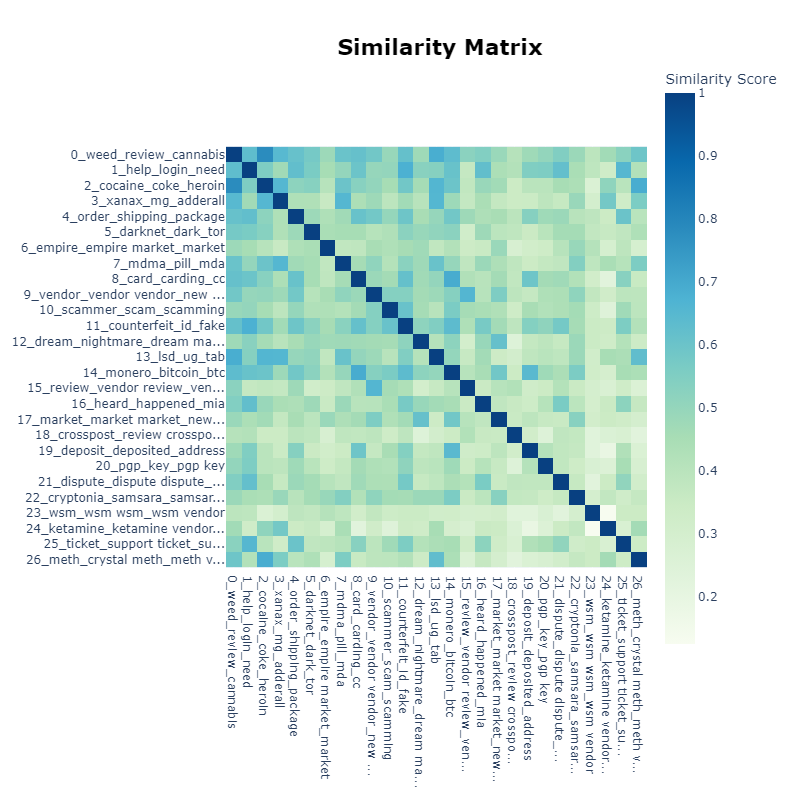

In [29]:
topic_model.visualize_hierarchy()

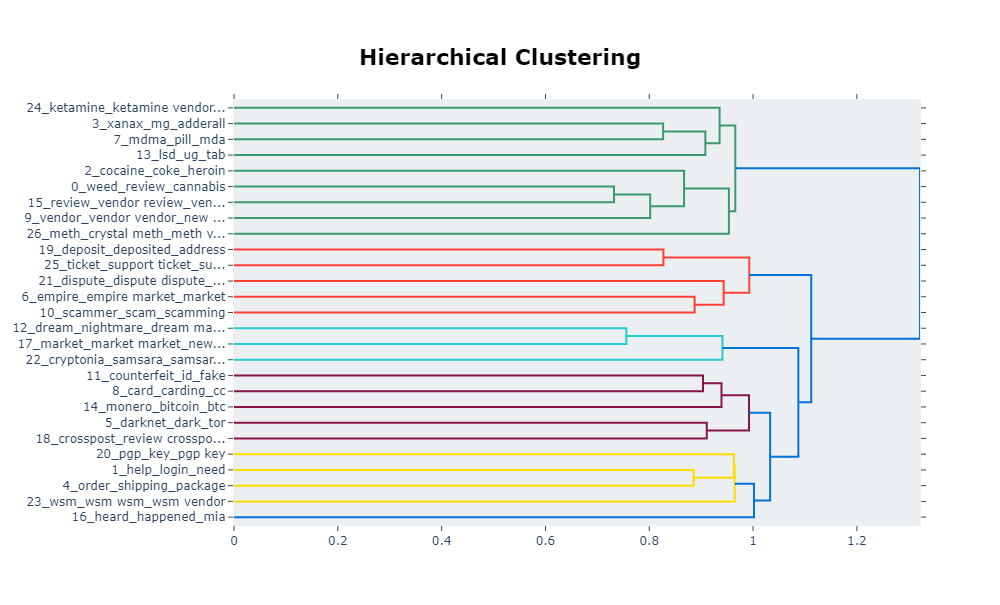

In [30]:
reduced_embeddings = UMAP(n_neighbors=15, n_components=2, 
                          min_dist=0.0, metric='cosine').fit_transform(tc1.corpus_embeddings)
topic_model.visualize_documents(tc1.corpus, reduced_embeddings=reduced_embeddings, 
                                hide_document_hover=True, hide_annotations=True)

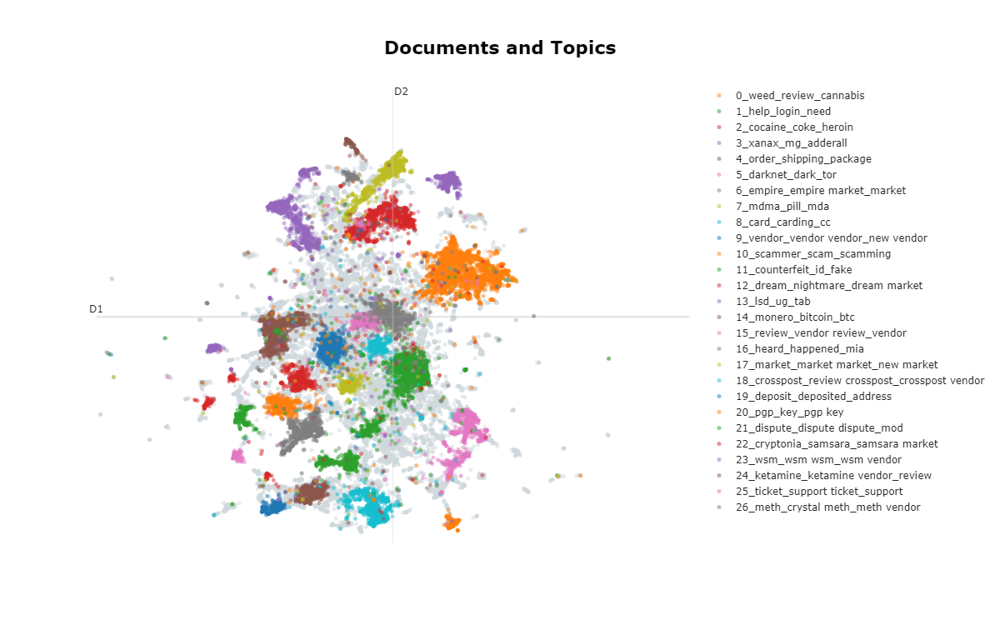

In [121]:
new_topics = topic_model.reduce_outliers(tc1.corpus, topics, strategy="embeddings", embeddings=tc1.corpus_embeddings, threshold=0.5)
topic_model.update_topics(tc1.corpus, topics=new_topics)
topic_model.get_topic_info()

2024-06-27 14:34:02,549 - BERTopic - WARNING: Using a custom list of topic assignments may lead to errors if topic reduction techniques are used afterwards. Make sure that manually assigning topics is the last step in the pipeline.Note that topic embeddings will also be created through weightedc-TF-IDF embeddings instead of centroid embeddings.


,Topic,Count,Name,Representation,Representative_Docs
0,-1,27323,-1_anyone_vendor_order_review,"[anyone, vendor, order, review, new, get, acco...",[dutchdrugz updates promo active till market p...
1,0,5137,0_weed_cannabis_cart_review,"[weed, cannabis, cart, review, thc, vendor, oz...",[sale girl scout cookie carts strains oz lb us...
2,1,2700,1_help_login_need_account,"[help, login, need, account, sub, back, passwo...","[hey really could use help advice thanks, erro..."
3,2,2601,2_cocaine_coke_heroin_drug,"[cocaine, coke, heroin, drug, vendor, uk, best...",[colombian coke brazil ship world wide promoti...
4,3,2270,3_xanax_mg_adderall_alprazolam,"[xanax, mg, adderall, alprazolam, bar, diazepa...","[adderall mg ir adderall mg xanax super sale, ..."
5,4,2031,4_order_shipping_package_delivery,"[order, shipping, package, delivery, shipped, ...","[informed delivery showing package, usa canada..."
6,5,1861,5_darknet_dark_tor_web,"[darknet, dark, tor, web, onion, dark web, dar...",[three student arrested dark web drug traffick...
7,6,1826,6_empire_empire market_empire empire_market,"[empire, empire market, empire empire, market,...","[empire anyone else, empire market back, empir..."
8,7,1653,7_mdma_pill_mda_xtc,"[mdma, pill, mda, xtc, mdma vendor, mg, usa, p...","[sale xtc pill mg mda us ca, uk mdma pill vend..."
9,8,1628,8_card_carding_cc_credit,"[card, carding, cc, credit, cvv, credit card, ...","[carding amazon gift card, gift card prepaid d..."


In [153]:
classifier = pipeline("zero-shot-classification", model="facebook/bart-large-mnli")

In [ ]:
zero_shot_topics = pd.read_csv('../../../Datasets/IntentCrime/intent_crime.csv')['intent'].tolist()
dict_zero_shots_25 = btu.assign_labels_to_topics(classifier, topic_model, zero_shot_topics, len(set(new_topics) - {-1}), threshold=.25)
dict_zero_shots_2 = btu.assign_labels_to_topics(classifier, topic_model, zero_shot_topics, len(set(new_topics) - {-1}), threshold=.2)
dict_zero_shots_17 = btu.assign_labels_to_topics(classifier, topic_model, zero_shot_topics, len(set(new_topics) - {-1}), threshold=.17)
dict_zero_shots_15 = btu.assign_labels_to_topics(classifier, topic_model, zero_shot_topics, len(set(new_topics) - {-1}), threshold=.15)

In [392]:
dict_zero_shots_2[18] = 'crosspost vendor'
dict_zero_shots_2[22] = 'samsara market'
dict_zero_shots_2[23] = 'wsm market'

In [ ]:
btu.save_assigned_labels(dict_zero_shots_25, 'ZeroShotClassificationResults/all-MiniLM-L6-v2_400/zero_shot_025.csv')
btu.save_assigned_labels(dict_zero_shots_2, 'ZeroShotClassificationResults/all-MiniLM-L6-v2_400/zero_shot_02.csv')
btu.save_assigned_labels(dict_zero_shots_17, 'ZeroShotClassificationResults/all-MiniLM-L6-v2_400/zero_shot_017.csv')
btu.save_assigned_labels(dict_zero_shots_15, 'ZeroShotClassificationResults/all-MiniLM-L6-v2_400/zero_shot_015.csv')

In [395]:
topic_model.set_topic_labels(dict_zero_shots_2)

In [396]:
topic_model.visualize_documents(tc1.corpus, reduced_embeddings=reduced_embeddings, 
                                hide_document_hover=True, hide_annotations=True, custom_labels=True)

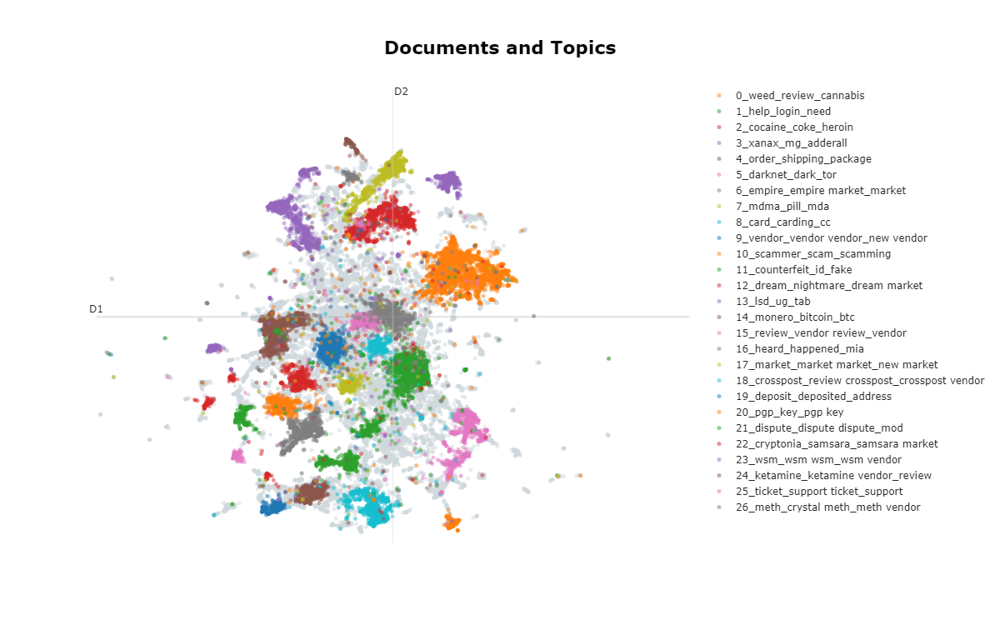

In [397]:
topic_model.visualize_hierarchy(custom_labels=True)

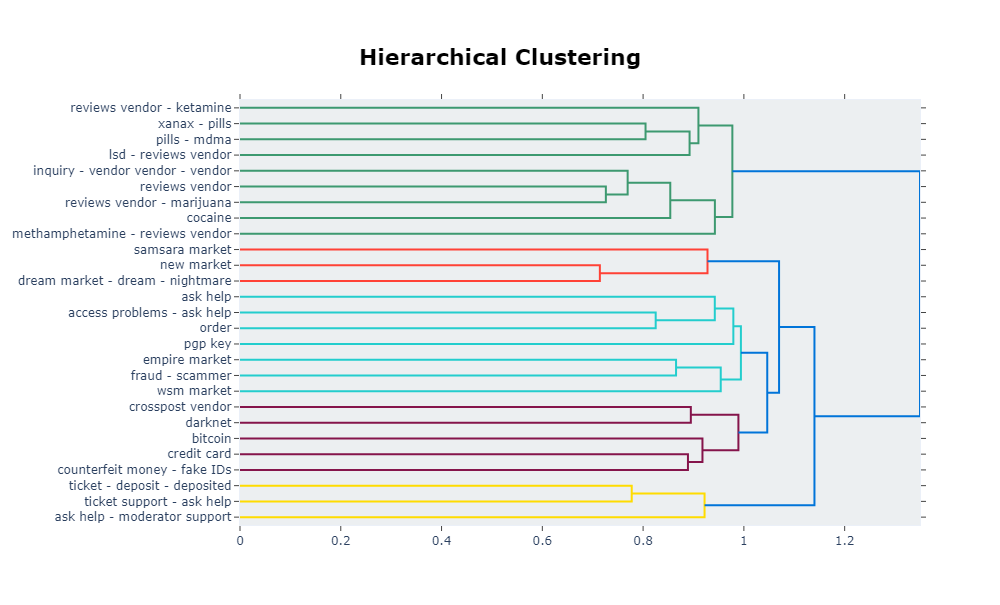

In [44]:
topic_model.visualize_topics()

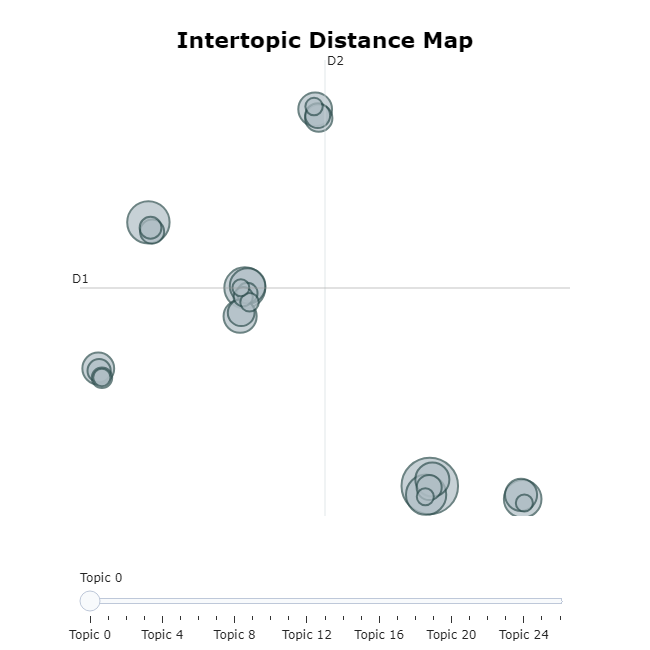

In [400]:
topic_model.visualize_barchart(top_n_topics=25, custom_labels=True, n_words=10)

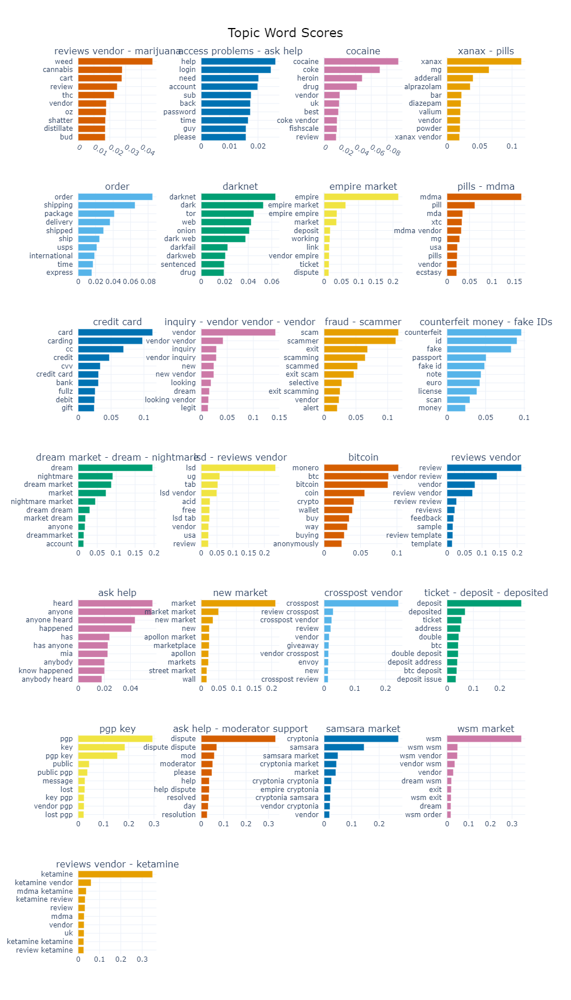

In [125]:
silhouette_scores, davies_bouldin_scores, X = btu.calculate_silhouette_davies(umap_embeddings, new_topics)

silhouette_score: 0.5175204277038574
Davies_bouldin_score: 0.7919422601150089


In [26]:
coherence_model = btu.evaluate_topic_coherence(topic_model.get_topics(), tc1.corpus)

Coherence Model: 0.5751057167740472


In [ ]:
df['name_thread'] = df['name_thread'].str.lower().dropna()
df.drop_duplicates(subset='name_thread', inplace=True)
df.dropna(subset=['name_thread'], inplace=True)
created_on = df['created_on'].tolist()
len(created_on)

In [406]:
topics_over_time = topic_model.topics_over_time(tc1.corpus, created_on, 
                                                global_tuning=True, evolution_tuning=True, nr_bins=100)
topic_model.visualize_topics_over_time(topics_over_time, top_n_topics=10, width=1250, height=700, custom_labels=True)

15it [00:24,  1.62s/it]


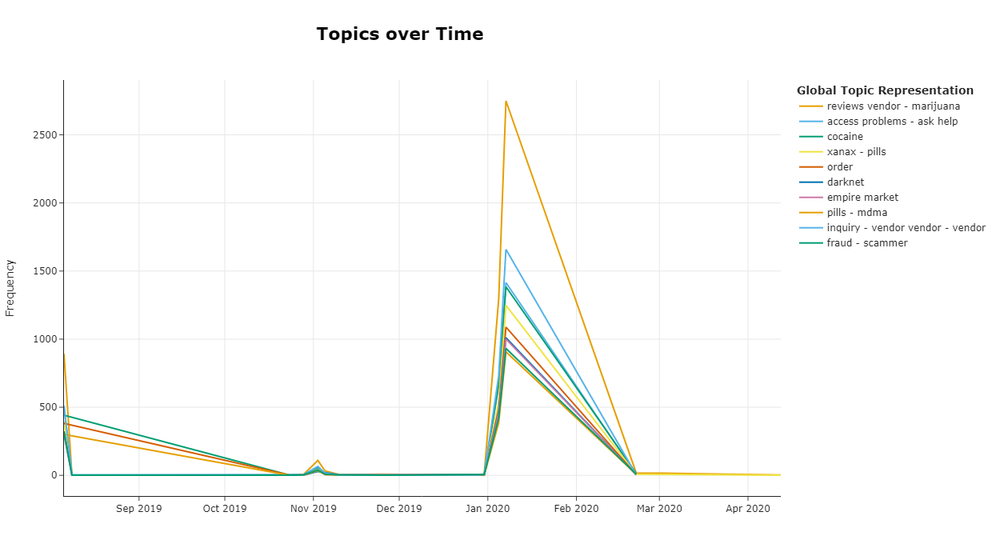

In [403]:
results_final = btu.return_dataset(tc1.corpus, created_on, tc1.corpus_embeddings, new_topics, probs, topic_model, umap_embeddings)
print(results_final.shape)
results_final.head()

(38274, 11)


,Document,Embedding,Topic,Probability,Created_on,Count,Name,CustomName,Representation,Representative_Docs,UMAP_embedding
0,review empire vendor acidbern,"[-0.07762138, -0.049061198, -0.046745114, -0.0...",6,0.527385,2020-01-09,1826,6_empire_empire market_empire empire_market,empire market,"[empire, empire market, empire empire, market,...","[empire anyone else, empire market back, empir...","[9.086779, 3.6718397, 8.9006195, -1.1745992, 1..."
1,vendor shipping combine priority,"[-0.027722627, -0.0031221025, 0.01195772, -0.0...",4,0.962274,2019-11-06,2031,4_order_shipping_package_delivery,order,"[order, shipping, package, delivery, shipped, ...","[informed delivery showing package, usa canada...","[9.679236, 2.7164314, 8.733615, 0.011899776, 8..."
2,open ticket since may ticket,"[0.055031013, -0.018210536, -0.0026789573, -0....",25,1.000000,2020-01-09,458,25_ticket_support ticket_support_please,ticket support - ask help,"[ticket, support ticket, support, please, mont...","[help support ticket please, help support tick...","[9.901975, 5.2703958, 11.463735, 0.47217792, 8..."
3,vendor inquiry destroid dream,"[-0.023196185, 0.0573189, 0.028408512, -0.0222...",9,0.000000,2019-11-06,3010,9_vendor_vendor vendor_inquiry_vendor inquiry,inquiry - vendor vendor - vendor,"[vendor, vendor vendor, inquiry, vendor inquir...",[nmm giving vendor runaround lying acting shad...,"[9.912251, 4.028657, 7.623224, -0.7158077, 9.2..."
4,morrison saver stamps uk money maker easiest m...,"[-0.020903945, 0.050762244, -0.041445963, 0.01...",11,0.799023,2020-01-09,1147,11_counterfeit_id_fake_passport,counterfeit money - fake IDs,"[counterfeit, id, fake, passport, fake id, not...","[buy counterfeit money real fake document, buy...","[9.859931, 3.1459394, 9.145497, -1.0489817, 9...."


In [ ]:
topic_model.save("Models/topic_model_all-MiniLM-L6-v2_400", serialization="pickle", save_ctfidf=True, save_embedding_model=model)

In [ ]:
topic_model.save("Models/topic_model_all-MiniLM-L6-v2_400_safetensors", serialization="safetensors", save_ctfidf=True, save_embedding_model=model)

In [405]:
results_final.to_parquet('DatasetsThreadBERTopic/BERTopic_all-MiniLM-L6-v2_400.parquet')

## 200 all-MiniLM-L6-v2

In [ ]:
mmr = MaximalMarginalRelevance(diversity=0.3)
kw = KeyBERTInspired()
vectorizer_model = CountVectorizer(stop_words="english")
ctfidf_model = ClassTfidfTransformer(reduce_frequent_words=True)
umap_model = UMAP(n_neighbors=15, n_components=10, min_dist=0.0, metric='cosine', random_state=42)
hdbscan_model = hdbscan.HDBSCAN(min_cluster_size=200, metric='euclidean', cluster_selection_method='eom', prediction_data=True)

topic_model = BERTopic(
    top_n_words=10, 
    n_gram_range=(1, 2),
    umap_model=umap_model, 
    hdbscan_model=hdbscan_model,
    vectorizer_model=vectorizer_model, 
    ctfidf_model=ctfidf_model, 
    representation_model=[mmr, kw],
    embedding_model=model,
    verbose=True
)

topics, probs = topic_model.fit_transform(tc1.corpus, tc1.corpus_embeddings)

In [ ]:
print(topic_model.get_topic_info())
for topic_id in set(topics):
    print(f"Topic {topic_id}:")
    print(topic_model.get_topic(topic_id))

In [6]:
topic_model.get_topic_info()

,Topic,Count,Name,Representation,Representative_Docs
0,-1,23926,-1_opiateconnect_heinekenexpress_buy_dmt,"[opiateconnect, heinekenexpress, buy, dmt, sho...","[good source dmt dream market, tramadol mg mg ..."
1,0,5394,0_carts_vape_cart_cannabis,"[carts, vape, cart, cannabis, marijuana, straw...",[mg thc gummies cherry raspberry strawberry fl...
2,1,2651,1_delivery_shipment_postage_delivered,"[delivery, shipment, postage, delivered, posta...","[package say delivered po box never got, mail ..."
3,2,2204,2_vendor_vendors_vendorbbmc_trusted,"[vendor, vendors, vendorbbmc, trusted, supplie...",[im looking vendor named buths bhuts shipping ...
4,3,1951,3_guy_post_community_sub,"[guy, post, community, sub, idea, posting, nig...","[sup fam ya boy ng min anybody legit right, hi..."
5,4,1715,4_empiremarket_empire_empiredealer_empireteam,"[empiremarket, empire, empiredealer, empiretea...","[empire vendor, give me empire, top empire ven..."
6,5,1694,5_dreammarket_market_markets_nightmaremarket,"[dreammarket, market, markets, nightmaremarket...","[miss dream ca nt use wallstreet market, wall ..."
7,6,1550,6_scamming_scammer_scam_scammers,"[scamming, scammer, scam, scammers, scams, sca...",[cottageindustry possibly exit scamming select...
8,7,1411,7_darkweb_sentenced_darknetmarketsnoobs_darkne...,"[darkweb, sentenced, darknetmarketsnoobs, dark...",[darkweb vendor happytimes sentenced five year...
9,8,1390,8_coca_cocain_cocacolacompany_cocainehcl,"[coca, cocain, cocacolacompany, cocainehcl, co...","[review high purity colombian coke brazil, ful..."


In [7]:
umap_embeddings = topic_model.umap_model.fit_transform(tc1.corpus_embeddings)
silhouette_scores, davies_bouldin_scores, X = btu.calculate_silhouette_davies(umap_embeddings, topics)

silhouette_score: 0.6660425662994385
Davies_bouldin_score: 0.3869296287979983


In [ ]:
topic_model.reduce_topics(tc1.corpus, nr_topics='auto')
topics = topic_model.topics_

In [9]:
topic_model.get_topic_info()

,Topic,Count,Name,Representation,Representative_Docs
0,-1,23926,-1_heinekenexpress_dmt_opiateconnect_tramadol,"[heinekenexpress, dmt, opiateconnect, tramadol...","[good source dmt dream market, need know start..."
1,0,11635,0_cannabis_sale_edibles_price,"[cannabis, sale, edibles, price, weed, shippin...",[adderall mg pharma gram aaa indoor nugs ounce...
2,1,4393,1_scamming_scammer_scam_scammed,"[scamming, scammer, scam, scammed, scams, phis...","[sale customer scamming alert vendor, partysqu..."
3,2,2651,2_delivery_package_shipment_postage,"[delivery, package, shipment, postage, shippin...","[package marked delivered never arrived, packa..."
4,3,1951,3_post_posting_advice_community,"[post, posting, advice, community, newbie, que...","[sup fam ya boy ng min anybody legit right, hi..."
5,4,1715,4_empire_empiremarket_empiredealer_empireteam,"[empire, empiremarket, empiredealer, empiretea...","[empire deposit support, empire now back, empi..."
6,5,1694,5_dreammarket_dream_dreams_dreaming,"[dreammarket, dream, dreams, dreaming, nightma...","[new wall st use dream quick question, dream m..."
7,6,1411,6_darkweb_darkbay_darknetmarkets_sentenced,"[darkweb, darkbay, darknetmarkets, sentenced, ...",[father son sentenced prison selling drugs dar...
8,7,1130,7_mdma_mdmamaster_mdmaus_mda,"[mdma, mdmamaster, mdmaus, mda, mdmamphetamine...",[best domestic mdma mda fast shipping tracked ...
9,8,911,8_det_dere_je_nede,"[det, dere, je, nede, noen, du, igjen, vous, s...","[hejlpe til finne ut av hva jeg har mottatt, z..."


In [10]:
umap_embeddings = topic_model.umap_model.fit_transform(tc1.corpus_embeddings)
silhouette_scores, davies_bouldin_scores, X = btu.calculate_silhouette_davies(umap_embeddings, topics)

silhouette_score: 0.34653472900390625
Davies_bouldin_score: 0.7209094786047956


In [11]:
vectorizer_model = CountVectorizer(stop_words="english", ngram_range=(1, 5))
topic_model.update_topics(tc1.corpus, vectorizer_model=vectorizer_model)

In [12]:
topic_model.visualize_topics()

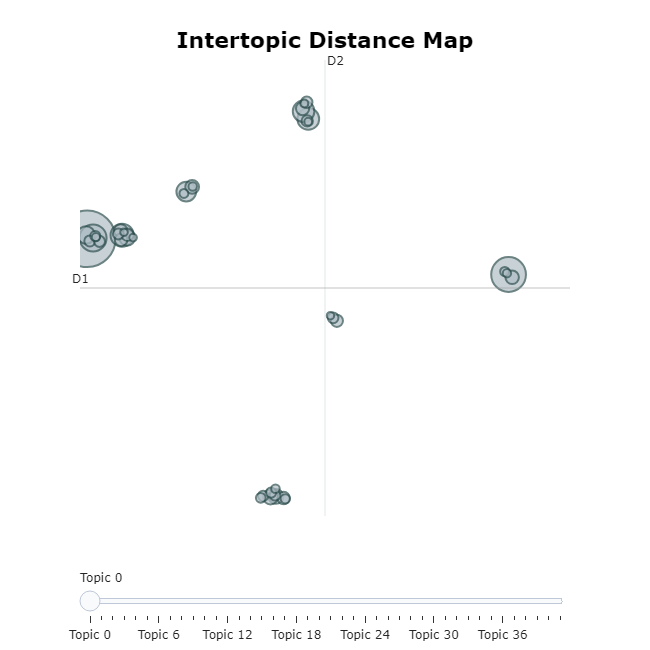

In [13]:
topic_model.visualize_hierarchy()

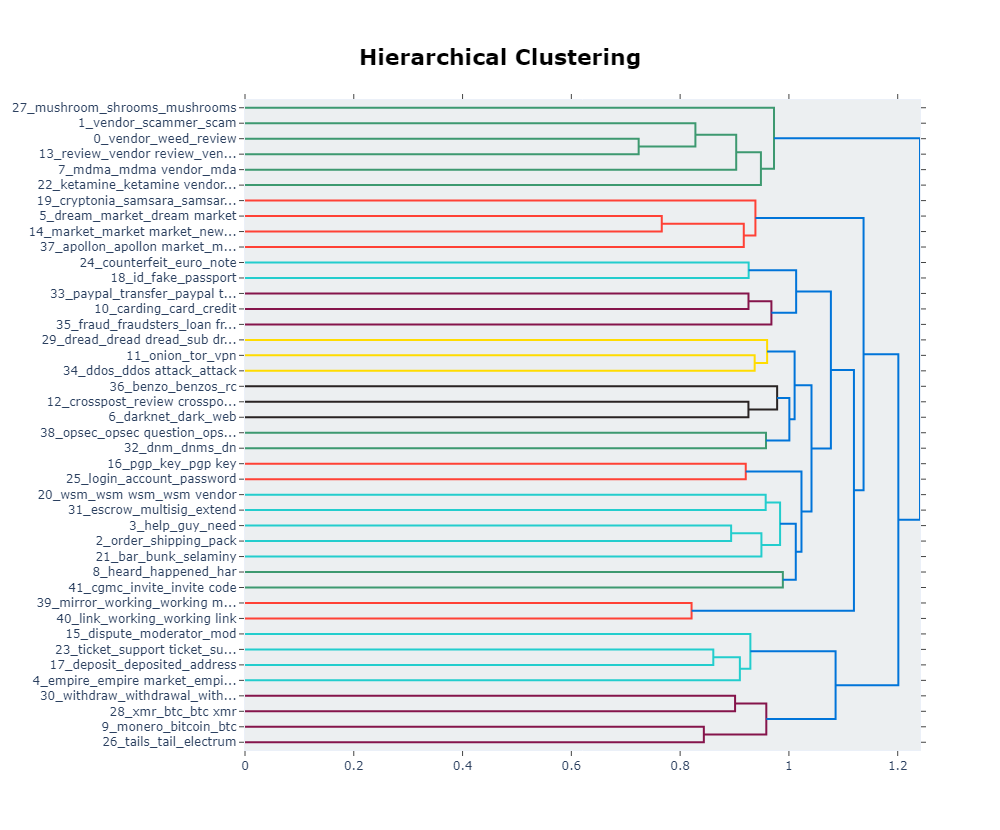

In [14]:
reduced_embeddings = UMAP(n_neighbors=15, n_components=2, 
                          min_dist=0.0, metric='cosine').fit_transform(tc1.corpus_embeddings)
topic_model.visualize_documents(tc1.corpus, reduced_embeddings=reduced_embeddings, 
                                hide_document_hover=True, hide_annotations=True)

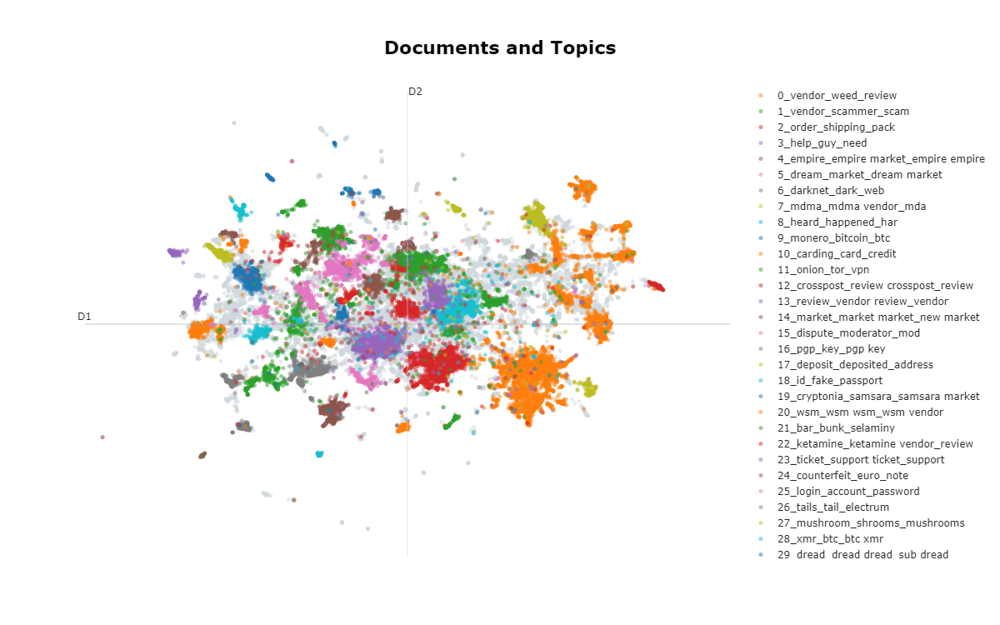

In [16]:
new_topics = topic_model.reduce_outliers(tc1.corpus, topics, strategy="embeddings", embeddings=tc1.corpus_embeddings, threshold=0.6)
topic_model.update_topics(tc1.corpus, topics=new_topics)
topic_model.get_topic_info()

2024-06-28 14:20:51,371 - BERTopic - WARNING: Using a custom list of topic assignments may lead to errors if topic reduction techniques are used afterwards. Make sure that manually assigning topics is the last step in the pipeline.Note that topic embeddings will also be created through weightedc-TF-IDF embeddings instead of centroid embeddings.


,Topic,Count,Name,Representation,Representative_Docs
0,-1,23556,-1_vendor_anyone_review_new,"[vendor, anyone, review, new, account, order, ...","[good source dmt dream market, need know start..."
1,0,11636,0_weed_xanax_lsd_review,"[weed, xanax, lsd, review, cocaine, mg, vendor...",[adderall mg pharma gram aaa indoor nugs ounce...
2,1,4422,1_vendor_scammer_scam_scamming,"[vendor, scammer, scam, scamming, exit, phishi...","[sale customer scamming alert vendor, partysqu..."
3,2,2655,2_order_shipping_pack_package,"[order, shipping, pack, package, delivery, shi...","[package marked delivered never arrived, packa..."
4,3,1952,3_help_guy_need_back,"[help, guy, need, back, day, time, question, a...","[sup fam ya boy ng min anybody legit right, hi..."
5,4,1734,4_empire_empire market_empire empire_market,"[empire, empire market, empire empire, market,...","[empire deposit support, empire now back, empi..."
6,5,1696,5_dream_dream market_nightmare_market,"[dream, dream market, nightmare, market, walls...","[new wall st use dream quick question, dream m..."
7,6,1411,6_darknet_dark_web_dark web,"[darknet, dark, web, dark web, darkfail, sente...",[father son sentenced prison selling drugs dar...
8,7,1151,7_mdma_mdma vendor_mda_usa,"[mdma, mdma vendor, mda, usa, sale, mdma revie...",[best domestic mdma mda fast shipping tracked ...
9,8,911,8_anyone_heard_happened_de,"[anyone, heard, happened, de, anyone heard, ha...","[hejlpe til finne ut av hva jeg har mottatt, z..."


In [ ]:
classifier = pipeline("zero-shot-classification", model="facebook/bart-large-mnli")

In [ ]:
zero_shot_topics = pd.read_csv('../../../Datasets/IntentCrime/intent_crime.csv')['intent'].tolist()
dict_zero_shots_25 = btu.assign_labels_to_topics(classifier, topic_model, zero_shot_topics, len(set(new_topics) - {-1}), threshold=.25)
dict_zero_shots_2 = btu.assign_labels_to_topics(classifier, topic_model, zero_shot_topics, len(set(new_topics) - {-1}), threshold=.2)

In [29]:
dict_zero_shots_25[1] = 'phishing - scamming'
dict_zero_shots_25[12] = 'crosspost vendor'
dict_zero_shots_25[19] = 'cryphtonia market'
dict_zero_shots_25[20] = 'wsm market'
dict_zero_shots_25[21] = 'bunk bar'
dict_zero_shots_25[31] = 'escrow service'
dict_zero_shots_25[39] = 'mirror link'
dict_zero_shots_25[40] = 'link'
dict_zero_shots_25[41] = 'cmgc - invite' 

In [ ]:
btu.save_assigned_labels(dict_zero_shots_25, 'ZeroShotClassificationResults/all-MiniLM-L6-v2_200/zero_shot_025.csv')
btu.save_assigned_labels(dict_zero_shots_2, 'ZeroShotClassificationResults/all-MiniLM-L6-v2_200/zero_shot_02.csv')

In [31]:
topic_model.set_topic_labels(dict_zero_shots_25)

In [32]:
topic_model.visualize_documents(tc1.corpus, reduced_embeddings=reduced_embeddings, 
                                hide_document_hover=True, hide_annotations=True, custom_labels=True)

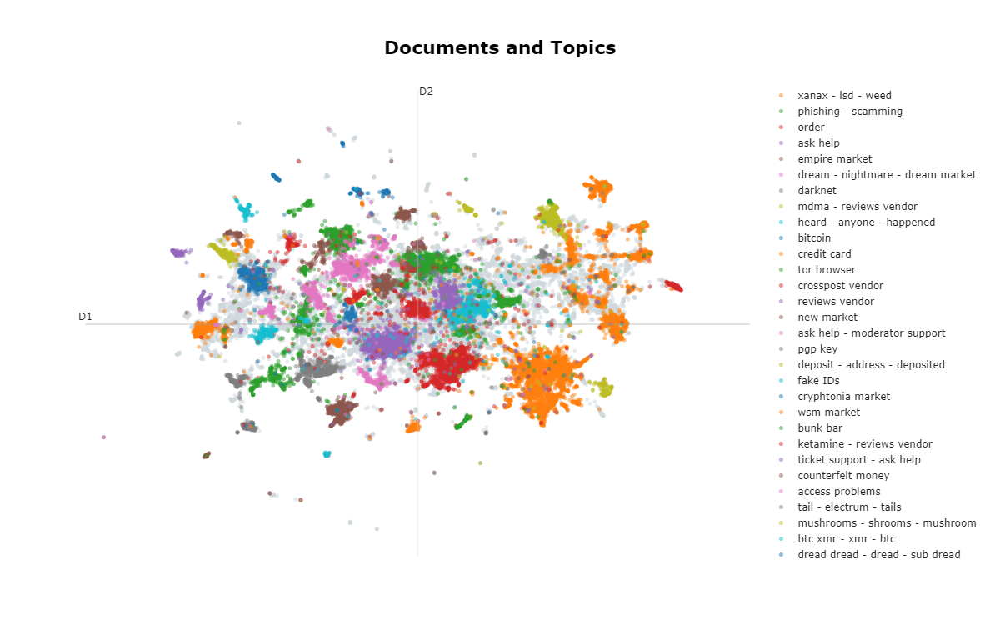

In [33]:
topic_model.visualize_barchart(top_n_topics=42, custom_labels=True, n_words=10)

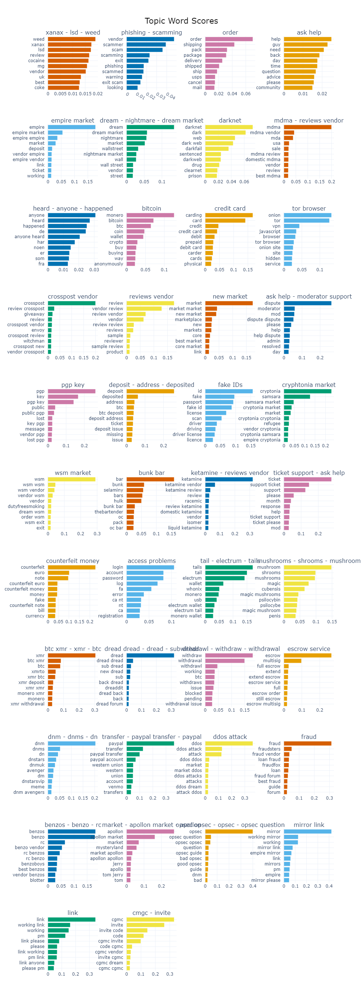

In [34]:
topic_model.visualize_topics()

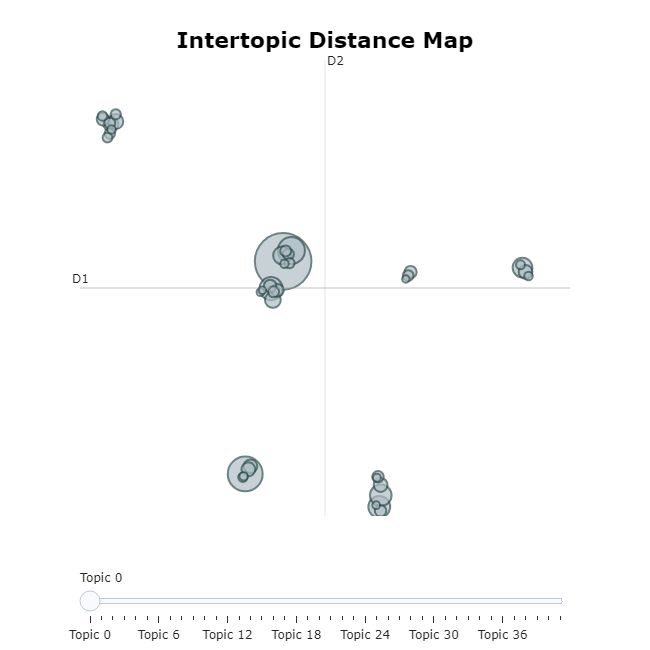

In [35]:
topic_model.visualize_hierarchy(custom_labels=True)

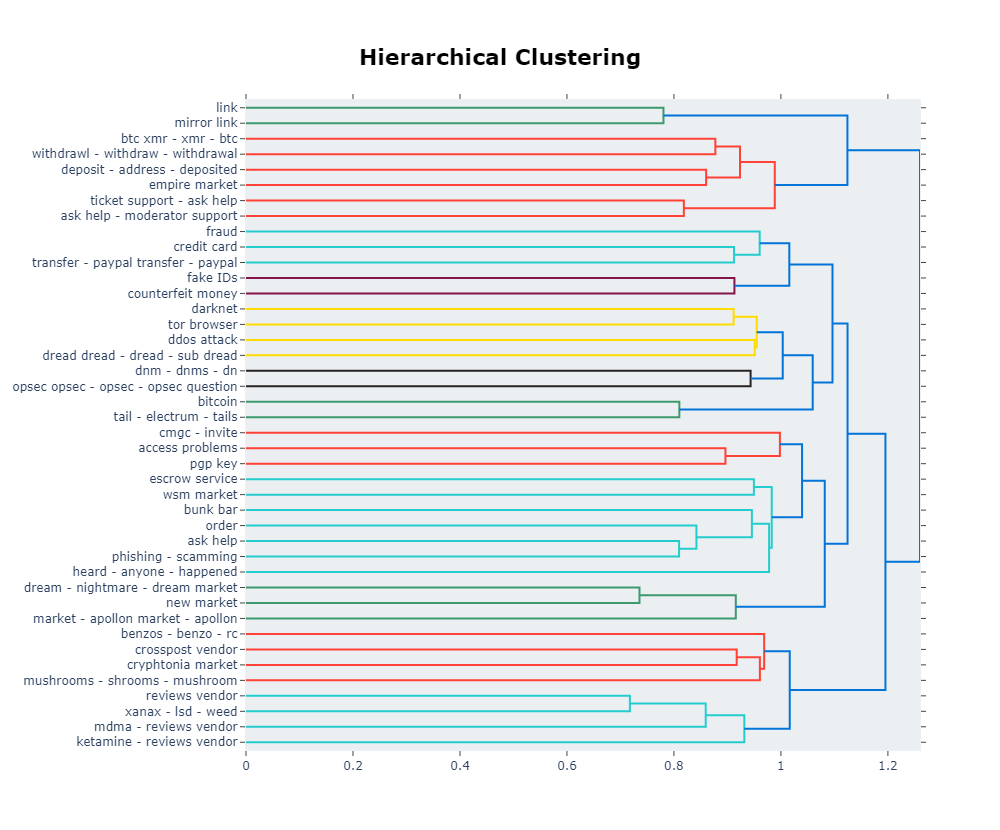

In [18]:
silhouette_scores, davies_bouldin_scores, X = btu.calculate_silhouette_davies(umap_embeddings, new_topics)

silhouette_score: 0.34653472900390625
Davies_bouldin_score: 0.7209094786047956


In [24]:
coherence_model = btu.evaluate_topic_coherence(topic_model.get_topics(), tc1.corpus)

Coherence Model: 0.5765415205607421


In [36]:
df['name_thread'] = df['name_thread'].str.lower().dropna()
df.drop_duplicates(subset='name_thread', inplace=True)
df.dropna(subset=['name_thread'], inplace=True)
created_on = df['created_on'].tolist()
len(created_on)

65529

In [37]:
topics_over_time = topic_model.topics_over_time(tc1.corpus, created_on, 
                                                global_tuning=True, evolution_tuning=True, nr_bins=100)
topic_model.visualize_topics_over_time(topics_over_time, top_n_topics=10, width=1250, height=700, custom_labels=True)

15it [00:25,  1.72s/it]


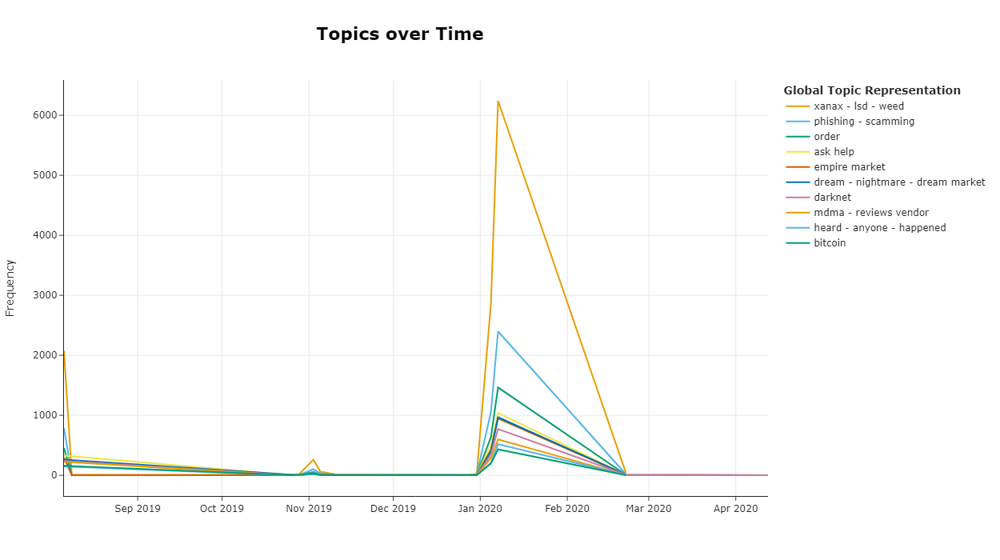

In [39]:
results_final = btu.return_dataset(tc1.corpus, created_on, tc1.corpus_embeddings, new_topics, probs, topic_model, umap_embeddings)
print(results_final.shape)
results_final.head()

(41973, 10)


,Document,Embedding,Topic,Probability,Created_on,Count,Name,CustomName,Representation,Representative_Docs
0,retirement sale one last blowout mdma dry spee...,"[-0.00200396, 0.060752388, 0.00081512495, -0.0...",7,0.393620,2020-01-09,1151,7_mdma_mdma vendor_mda_usa,mdma - reviews vendor,"[mdma, mdma vendor, mda, usa, sale, mdma revie...",[best domestic mdma mda fast shipping tracked ...
1,cash deposit,"[-0.0044404618, 0.016640304, -0.035438363, 0.0...",17,0.539291,2019-11-06,578,17_deposit_deposited_address_btc,deposit - address - deposited,"[deposit, deposited, address, btc, btc deposit...",[generated deposit address deposited multiple ...
2,import meth contact tracking,"[-0.05514505, -0.042183764, -0.060674116, -0.0...",0,1.000000,2020-01-09,11636,0_weed_xanax_lsd_review,xanax - lsd - weed,"[weed, xanax, lsd, review, cocaine, mg, vendor...",[adderall mg pharma gram aaa indoor nugs ounce...
3,please need working links,"[0.013639548, -0.030973928, -0.05787297, 0.026...",40,1.000000,2020-01-09,213,40_link_working link_working_pm,link,"[link, working link, working, pm, link please,...","[working link please pm, please pm someone wor..."
4,reliable dexedrine vendor,"[-0.09150407, -0.024179617, 0.027147656, -0.06...",0,0.404354,2020-01-09,11636,0_weed_xanax_lsd_review,xanax - lsd - weed,"[weed, xanax, lsd, review, cocaine, mg, vendor...",[adderall mg pharma gram aaa indoor nugs ounce...


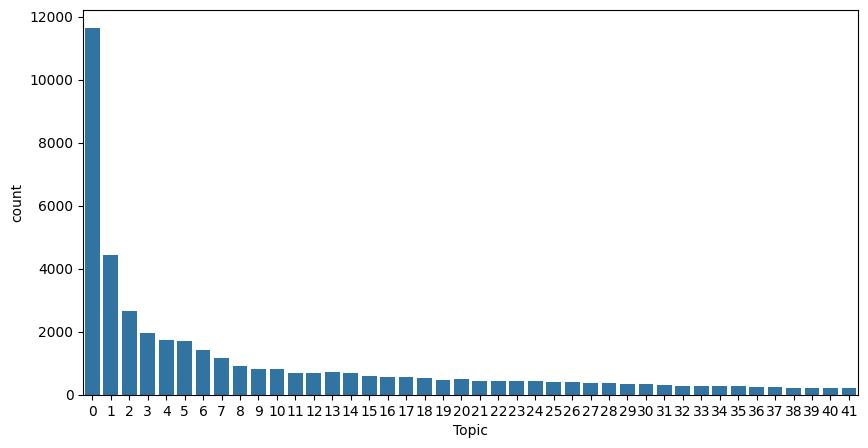

In [49]:
plt.figure(figsize=(10, 5))
sns.countplot(results_final, x='Topic', orient='h');

In [50]:
topic_model.save("Models/topic_model_all-MiniLM-L6-v2_200", serialization="pickle", save_ctfidf=True, save_embedding_model=model)

2024-06-28 16:03:43,246 - BERTopic - WARNING: When you use `pickle` to save/load a BERTopic model,please make sure that the environments in which you saveand load the model are **exactly** the same. The version of BERTopic,its dependencies, and python need to remain the same.


In [52]:
topic_model.save("Models/topic_model_all-MiniLM-L6-v2_200_safetensors", serialization="safetensors", save_ctfidf=True, save_embedding_model=model)

In [53]:
results_final.to_parquet('DatasetsThreadBERTopic/BERTopic_all-MiniLM-L6-v2_200.parquet')

In [2]:
import nbconvert

!jupyter nbconvert --to html show_results_thread.ipynb

[NbConvertApp] Converting notebook show_results_thread.ipynb to html
C:\Users\dommy\miniconda3\envs\gestione\share\jupyter\nbconvert\templates\base\display_priority.j2:32: UserWarning: Your element with mimetype(s) dict_keys(['application/vnd.plotly.v1+json']) is not able to be represented.
  {%- elif type == 'text/vnd.mermaid' -%}
[NbConvertApp] WARNING | Alternative text is missing on 7 image(s).
[NbConvertApp] Writing 7742849 bytes to show_results_thread.html


## 20n 150 all-MiniLM-L6-v2

In [ ]:
df = btu.load_data_filtered('cleaned_data_name_thread.zip', 'name_thread')

In [ ]:
model = SentenceTransformer('all-MiniLM-L6-v2')
tc1 = tc.TextClustering(df, 'name_thread')
tc1.encode_corpus(model, batch_size=64, to_tensor=False)

In [117]:
mmr = MaximalMarginalRelevance(diversity=0.3)
kw = KeyBERTInspired()
vectorizer_model = CountVectorizer(stop_words="english")
ctfidf_model = ClassTfidfTransformer(reduce_frequent_words=True)
umap_model = UMAP(n_neighbors=20, n_components=10, min_dist=0.0, metric='cosine', random_state=42)
hdbscan_model = hdbscan.HDBSCAN(min_cluster_size=150, metric='euclidean', cluster_selection_method='eom', prediction_data=True)

topic_model = BERTopic(
    top_n_words=10, 
    n_gram_range=(1, 2),
    umap_model=umap_model, 
    hdbscan_model=hdbscan_model,
    vectorizer_model=vectorizer_model, 
    ctfidf_model=ctfidf_model, 
    representation_model=[mmr, kw],
    embedding_model=model,
    calculate_probabilities=True,
    verbose=True
)

topics, probs = topic_model.fit_transform(tc1.corpus, tc1.corpus_embeddings)

2024-06-30 15:40:03,123 - BERTopic - Dimensionality - Fitting the dimensionality reduction algorithm
2024-06-30 15:42:22,877 - BERTopic - Dimensionality - Completed ✓
2024-06-30 15:42:22,905 - BERTopic - Cluster - Start clustering the reduced embeddings
2024-06-30 15:43:23,274 - BERTopic - Cluster - Completed ✓
2024-06-30 15:43:23,475 - BERTopic - Representation - Extracting topics from clusters using representation models.
2024-06-30 15:44:03,645 - BERTopic - Representation - Completed ✓


In [118]:
vectorizer_model = CountVectorizer(stop_words="english", ngram_range=(1, 5))
topic_model.update_topics(tc1.corpus, vectorizer_model=vectorizer_model)

In [119]:
topic_model.get_topic_info()

,Topic,Count,Name,Representation,Representative_Docs
0,-1,24995,-1_vendor_review_market_new,"[vendor, review, market, new, order, account, ...",[review vendor cdnven product china white synt...
1,0,4998,0_weed_cannabis_cart_thc,"[weed, cannabis, cart, thc, review, oz, hash, ...",[product vendor review ml lemon kush wax vape ...
2,1,1948,1_help_need_guy_sub,"[help, need, guy, sub, day, question, post, ad...","[hi guy update post, way make sub like old red..."
3,2,1845,2_order_shipping_package_pack,"[order, shipping, package, pack, delivery, shi...","[package show informed delivery, usps informed..."
4,3,1728,3_empire_empire market_empire empire_market,"[empire, empire market, empire empire, market,...","[empire back, empire market back, empire suppo..."
...,...,...,...,...,...
64,63,191,63_dmt_dmt vendor_odsmt_dmt dmt,"[dmt, dmt vendor, odsmt, dmt dmt, bluefairy, c...","[best dmt vendor, dmt, vendor dmt]"
65,64,186,64_captcha_rapture_rapture market_captcha captcha,"[captcha, rapture, rapture market, captcha cap...","[captcha, use rapture registration login captc..."
66,65,181,65_chemical_research_research chemical_chems,"[chemical, research, research chemical, chems,...",[chem theory honorable research chemical suppl...
67,66,166,66_tor_browser_tor browser_tor network,"[tor, browser, tor browser, tor network, netwo...","[tor browser help, review tor browser, tor bro..."


In [120]:
umap_embeddings = topic_model.umap_model.fit_transform(tc1.corpus_embeddings)
silhouette_scores, davies_bouldin_scores, X = btu.calculate_silhouette_davies(umap_embeddings, topics)

silhouette_score: 0.6823439598083496
Davies_bouldin_score: 0.3791311194398217


In [136]:
new_topics = topic_model.reduce_outliers(tc1.corpus, topics, strategy="embeddings", embeddings=tc1.corpus_embeddings, threshold=0.46)
topic_model.update_topics(tc1.corpus, topics=new_topics)
topic_model.get_topic_info()

2024-06-30 16:01:57,452 - BERTopic - WARNING: Using a custom list of topic assignments may lead to errors if topic reduction techniques are used afterwards. Make sure that manually assigning topics is the last step in the pipeline.Note that topic embeddings will also be created through weightedc-TF-IDF embeddings instead of centroid embeddings.


,Topic,Count,Name,Representation,Representative_Docs
0,-1,18900,-1_anyone_get_update_review,"[anyone, get, update, review, new, order, acco...",[review vendor cdnven product china white synt...
1,0,5021,0_weed_cannabis_cart_thc,"[weed, cannabis, cart, thc, review, hash, shat...",[product vendor review ml lemon kush wax vape ...
2,1,2035,1_help_guy_sub_need,"[help, guy, sub, need, back, question, day, ad...","[hi guy update post, way make sub like old red..."
3,2,2005,2_order_shipping_package_pack,"[order, shipping, package, pack, delivery, shi...","[package show informed delivery, usps informed..."
4,3,1815,3_empire_empire market_empire empire_market,"[empire, empire market, empire empire, market,...","[empire back, empire market back, empire suppo..."
...,...,...,...,...,...
64,63,202,63_dmt_dmt vendor_dmt vape_odsmt,"[dmt, dmt vendor, dmt vape, odsmt, dmt dmt, ch...","[best dmt vendor, dmt, vendor dmt]"
65,64,187,64_captcha_rapture_rapture market_captcha captcha,"[captcha, rapture, rapture market, captcha cap...","[captcha, use rapture registration login captc..."
66,65,198,65_chemical_research_research chemical_chems,"[chemical, research, research chemical, chems,...",[chem theory honorable research chemical suppl...
67,66,222,66_tor_tor browser_browser_tor network,"[tor, tor browser, browser, tor network, netwo...","[tor browser help, review tor browser, tor bro..."


In [137]:
btu.print_topics(topic_model, topics)

Topic 0:
[('weed', 0.034440655421142205), ('cannabis', 0.02163153800597487), ('cart', 0.02131043599512726), ('thc', 0.01824969706580151), ('review', 0.014699009276947663), ('hash', 0.013941473812216146), ('shatter', 0.01385956329618397), ('distillate', 0.013788654857474974), ('oz', 0.013699156416790433), ('bud', 0.013511109713200431)]
Topic 1:
[('help', 0.020902783340739296), ('guy', 0.018141447515630817), ('sub', 0.018061502588594965), ('need', 0.017228855503283312), ('back', 0.015478023601901827), ('question', 0.014588537674805049), ('day', 0.014103368936720316), ('advice', 0.013364282528612713), ('shit', 0.01315161003792278), ('post', 0.013047995251142981)]
Topic 2:
[('order', 0.05141015231966171), ('shipping', 0.049459163735666216), ('package', 0.034053136968648846), ('pack', 0.03022209818441062), ('delivery', 0.02795081519396416), ('shipped', 0.02329856657883124), ('ship', 0.018460022471923705), ('usps', 0.01791841479902273), ('delivered', 0.013805279333056695), ('international', 

In [138]:
topic_model.visualize_topics()

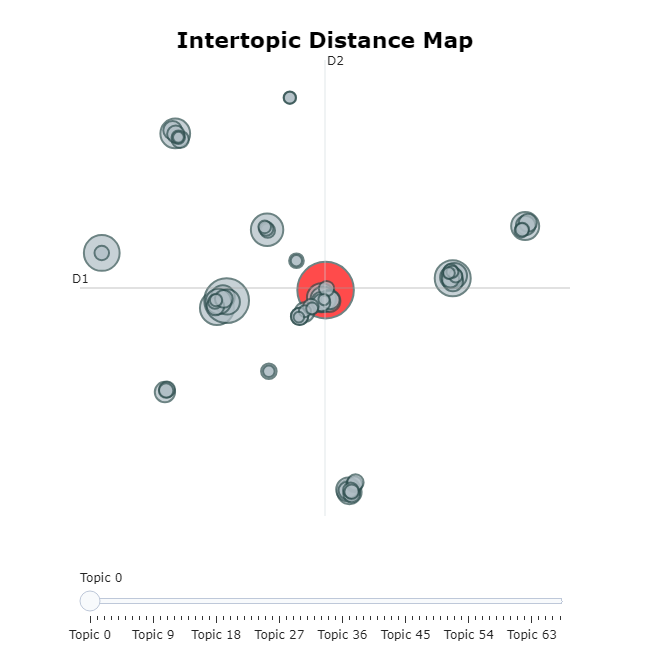

In [139]:
silhouette_scores, davies_bouldin_scores, X = btu.calculate_silhouette_davies(umap_embeddings, new_topics)

silhouette_score: 0.48274117708206177
Davies_bouldin_score: 0.8687026513069406


In [140]:
coherence_model = btu.evaluate_topic_coherence(topic_model.get_topics(), tc1.corpus)

Coherence Model: 0.5645685188607535


In [92]:
dos_score = btu.calculate_dos(topic_model.get_topics())

Distinta Overlap Score: 0.06308610400682012


In [ ]:
classifier = pipeline("zero-shot-classification", model="facebook/bart-large-mnli")

In [189]:
zero_shot_topics = pd.read_csv('../../../Datasets/IntentCrime/intent_crime.csv')['intent'].tolist()
dict_zero_shots_25 = btu.assign_labels_to_topics(classifier, topic_model, zero_shot_topics, len(set(new_topics) - {-1}), threshold=.25)

Assigning labels to topics:   0%|          | 0/68 [00:00<?, ?it/s]

Assigning labels to topics: 100%|██████████| 68/68 [42:46<00:00, 37.74s/it] 


In [ ]:
dict_zero_shots_25[1] = 'ask help - ask help post'
dict_zero_shots_25[2] = 'order'
dict_zero_shots_25[10] = 'crosspost vendor'
dict_zero_shots_25[13] = 'dream market - dread'
dict_zero_shots_25[14] = 'ask help - moderator'
dict_zero_shots_25[15] = 'cocaine vendor - cocaine'
dict_zero_shots_25[20] = 'bunk bar'
dict_zero_shots_25[28] = 'wsm vendor - wsm market'
dict_zero_shots_25[39] = 'cryptonia market - dread'
dict_zero_shots_25[41] = 'escrow service'
dict_zero_shots_25[48] = 'event happened'
dict_zero_shots_25[51] = 'dream - dream vendor - dread'
dict_zero_shots_25[52] = 'order cancelled'
dict_zero_shots_25[57] = 'opsec questions'
dict_zero_shots_25[58] = 'link'
dict_zero_shots_25[59] = 'mirror - mirror link - working mirror'
dict_zero_shots_25[64] = 'capcha'

In [ ]:
btu.save_assigned_labels(dict_zero_shots_25, 'ZeroShotClassificationResults/all-MiniLM-L6-v2_150_20n/zero_shot_025.csv')

In [235]:
topic_model.set_topic_labels(dict_zero_shots_25)

In [236]:
reduced_embeddings = UMAP(n_neighbors=15, n_components=2, 
                          min_dist=0.0, metric='cosine').fit_transform(tc1.corpus_embeddings)
topic_model.visualize_documents(tc1.corpus, reduced_embeddings=reduced_embeddings, 
                                hide_document_hover=True, hide_annotations=True, custom_labels=True)

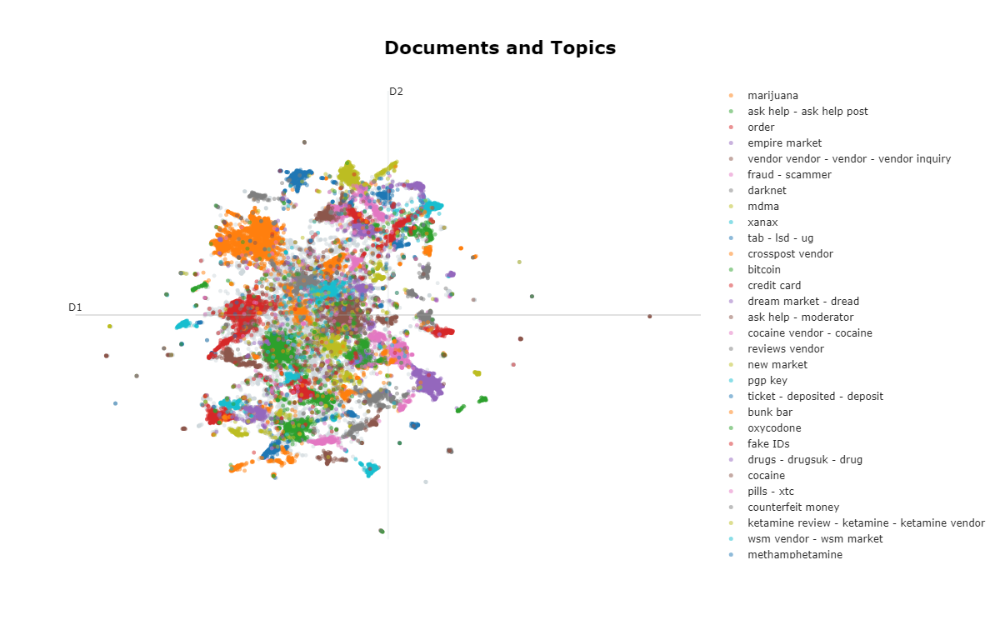

In [ ]:
topic_model.visualize_barchart(top_n_topics=70, custom_labels=True, n_words=10)

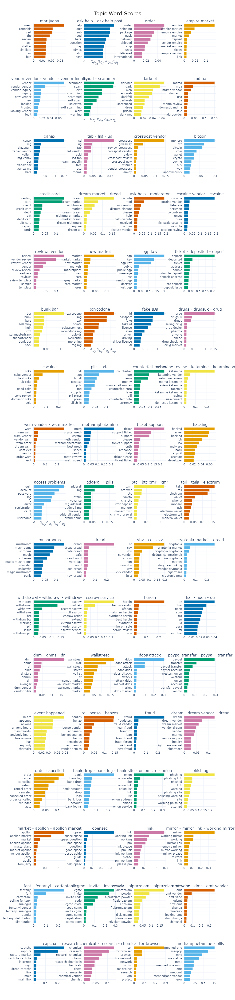

In [ ]:
topic_model.visualize_hierarchy(custom_labels=True)

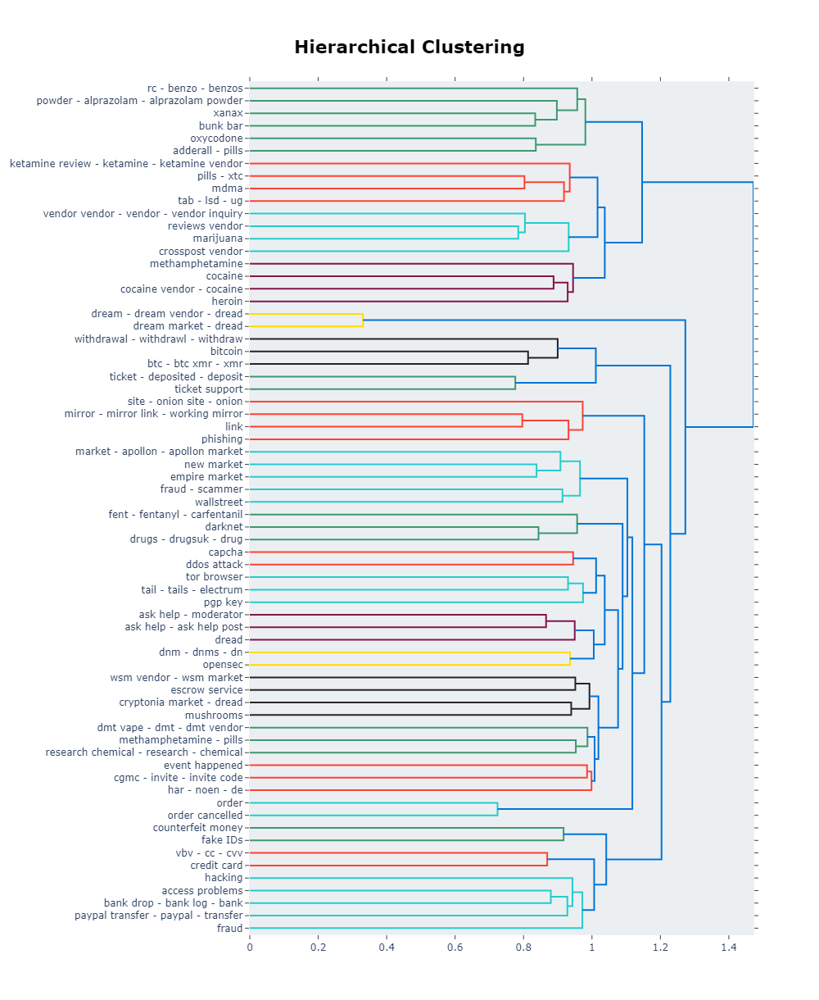

In [5]:
topic_model.visualize_heatmap(custom_labels=True)

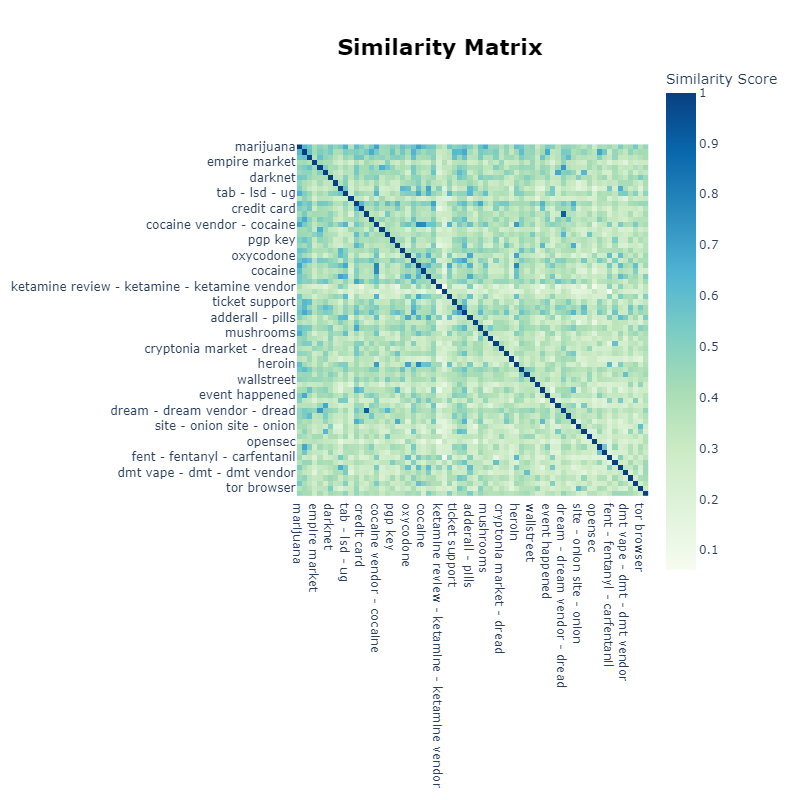

In [ ]:
df['name_thread'] = df['name_thread'].str.lower().dropna()
df.drop_duplicates(subset='name_thread', inplace=True)
df.dropna(subset=['name_thread'], inplace=True)
created_on = df['created_on'].tolist()

In [239]:
topics_over_time = topic_model.topics_over_time(tc1.corpus, created_on, 
                                                global_tuning=True, evolution_tuning=True, nr_bins=100)
topic_model.visualize_topics_over_time(topics_over_time, top_n_topics=10, width=1250, height=700, custom_labels=True)

15it [00:22,  1.52s/it]


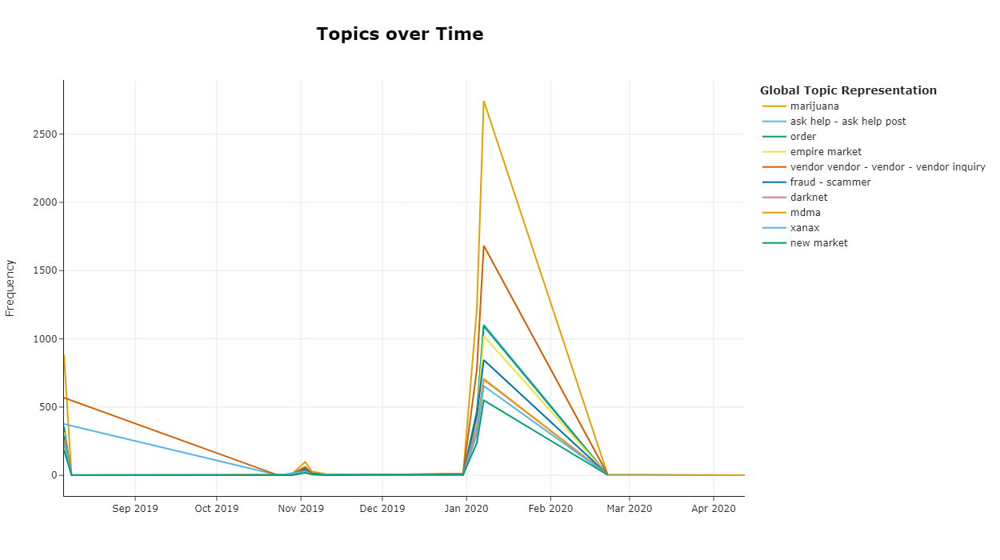

In [240]:
results_final = btu.return_dataset(tc1.corpus, created_on, tc1.corpus_embeddings, new_topics, probs, topic_model, umap_embeddings)
print(results_final.shape)
results_final.head()

(46629, 10)


,Document,Embedding,Topic,Probability,Created_on,Count,Name,CustomName,Representation,Representative_Docs
0,naturalmeds apollon,"[-0.11246682, -0.03748099, 0.04490077, 0.01724...",56,"[1.1964202652021368e-307, 6.589650224023648e-3...",2020-01-09,242,56_apollon_apollon market_market_apollon apollon,market - apollon - apollon market,"[apollon, apollon market, market, apollon apol...","[back apollon, apollon, apollon market]"
1,redemption btc giveaway coke sub dread member ...,"[-0.043700494, -0.032600075, 0.0051953266, 0.0...",24,"[0.006596099708564405, 0.003763170646085399, 0...",2020-01-09,544,24_coke_coke vendor_best coke_uk coke,cocaine,"[coke, coke vendor, best coke, uk coke, uk, go...","[fire coke, coke vendor , coke vendor]"
2,flubromazolam sample giveaway,"[-0.04101017, 0.007629349, -0.07528322, -0.033...",62,"[8.335712654832696e-308, 7.430095287264378e-30...",2019-11-06,290,62_alprazolam_powder_alprazolam powder_flualpr...,powder - alprazolam - alprazolam powder,"[alprazolam, powder, alprazolam powder, flualp...",[usa domestic alprazolam powder mxe apvp inbom...
3,cigarette tobacco replica,"[-0.07527819, 0.13146353, -0.07912154, -0.0353...",0,"[0.040079176553298505, 0.007976173889767435, 0...",2020-01-09,5021,0_weed_cannabis_cart_thc,marijuana,"[weed, cannabis, cart, thc, review, hash, shat...",[product vendor review ml lemon kush wax vape ...
4,requiring image image review,"[-0.014864997, 0.08211257, 0.004136639, 0.0027...",16,"[0.006753134223967767, 0.007309909359113744, 0...",2019-11-06,998,16_review_vendor review_review vendor_vendor,reviews vendor,"[review, vendor review, review vendor, vendor,...",[xpost danknation vendor review sunaero multis...


In [241]:
results_final.to_parquet('DatasetsThreadBERTopic/BERTopic_all-MiniLM-L6-v2_150_20n.parquet')

In [ ]:
topic_model.save("Models/topic_model_all-MiniLM-L6-v2_150_20n", serialization="pickle", save_ctfidf=True, save_embedding_model=model)

In [243]:
topic_model.save("Models/topic_model_all-MiniLM-L6-v2_150_20n_safetensors", serialization="safetensors", save_ctfidf=True, save_embedding_model=model)

In [69]:
topic_model = BERTopic.load("Models/topic_model_all-MiniLM-L6-v2_150_20n")

In [244]:
sentence = ['recently closed Samsara market']
tp, pr = topic_model.transform(sentence)

Batches: 100%|██████████| 1/1 [00:00<00:00,  2.00it/s]
2024-06-30 21:54:03,236 - BERTopic - Dimensionality - Reducing dimensionality of input embeddings.
2024-06-30 21:54:08,543 - BERTopic - Dimensionality - Completed ✓
2024-06-30 21:54:08,544 - BERTopic - Clustering - Approximating new points with `hdbscan_model`
2024-06-30 21:54:08,576 - BERTopic - Probabilities - Start calculation of probabilities with HDBSCAN
2024-06-30 21:54:08,699 - BERTopic - Probabilities - Completed ✓
2024-06-30 21:54:08,701 - BERTopic - Cluster - Completed ✓


In [248]:
top_indices = np.argsort(pr[0])[::-1][:5]
top_topics = [(topic_model.get_topic(i), pr[0][i], topic_model.custom_labels_[i+1]) for i in top_indices]
df_finals = pd.DataFrame(top_topics, columns=['Topic', 'Probability', 'Label'])
df_finals['Words'] = df_finals['Topic'].apply(lambda topic: [word for word, prob in topic])
df_finals['Sentence'] = sentence * len(df_finals)
df_finals

,Topic,Probability,Label,Words,Sentence
0,"[(cryptonia, 0.270593329016721), (cryptonia ma...",0.002991,cryptonia market - dread,"[cryptonia, cryptonia market, cryptonia crypto...",recently closed Samsara market
1,"[(empire, 0.1408905571475779), (empire market,...",0.002262,empire market,"[empire, empire market, empire empire, market,...",recently closed Samsara market
2,"[(wallstreet, 0.17075397467717646), (wall, 0.1...",0.002127,wallstreet,"[wallstreet, wall, wall street, street, wall s...",recently closed Samsara market
3,"[(scammer, 0.09029491748260987), (scam, 0.0879...",0.002075,fraud - scammer,"[scammer, scam, exit, scamming, scammed, exit ...",recently closed Samsara market
4,"[(crosspost, 0.14470709618860572), (giveaway, ...",0.002045,crosspost vendor,"[crosspost, giveaway, review crosspost, crossp...",recently closed Samsara market


In [109]:
topic_model.get_topic(tp[0])

[('anyone', 0.009415205712082564),
 ('update', 0.007916840604830654),
 ('address', 0.006939392479966835),
 ('new', 0.006268540212828576),
 ('get', 0.006179372827051399),
 ('vacation', 0.0059803996923821),
 ('has', 0.0058347636749867746),
 ('need', 0.005401699096715211),
 ('drop', 0.005394598005495695),
 ('listing', 0.005367223382048893)]

## OTHER - No Preprocessing


In [2]:
df = btu.load_data_filtered('../merged_data.zip', 'name_thread')

68931


In [3]:
df.head()

,name_board,creator_thread,creator_id_thread,name_thread,created_on,registration_date,total_posts,reputation,creator_post,creator_id_post,content,created_on_post
0,Tor,blonger,32544,"Tor shrinked of about 13,5% but you can contri...",2020-01-09,1900-01-01 00:00:00,0.0,0.0,[deleted],37,[removed],2019-10-16
2,Tor,Xanitforthecash,2467,should I run a tor node,2020-01-09,2018-03-21 00:00:00,88.0,9.0,rswz,32661,***LINK***http://ea5faa5po25cf7fb.onion/projec...,2019-10-16
7,Tor,Syndicate,33036,Tor Browser 9.0!,2019-11-06,1900-01-01 00:00:00,0.0,0.0,Syndicate,33036,Tor Browser 9.0 is now available from the Tor ...,2019-10-30
9,Tor,Syndicate,33036,[UPDATED] Tor Security Guide Crosspost,2019-11-06,1900-01-01 00:00:00,0.0,0.0,Syndicate,33036,***LINK***[UPDATED] Tor Security Guide[/post/9...,2019-10-30
10,Tor,wekhiu48,1178,"/u/CostcoRotisserieChicken spreading FUD, Let'...",2020-01-09,2019-05-24 00:00:00,1355.0,342.0,wekhiu48,1178,***LINK***/u/CostcoRotisserieChicken spreading...,2019-10-30


In [112]:
model = SentenceTransformer('all-MiniLM-L6-v2')
tc1 = tc.TextClustering(df, 'name_thread')
tc1.encode_corpus(model, batch_size=64, to_tensor=False)

2024-07-01 16:22:21,480 - PreProcessingText - INFO - Encoding the corpus. This might take a while.
Batches: 100%|██████████| 1065/1065 [10:23<00:00,  1.71it/s]


array([[-2.8301043e-02,  1.2166312e-02,  8.7255865e-02, ...,
        -8.3833829e-02, -9.1334045e-02, -5.1197205e-02],
       [-4.2577364e-02,  2.9390754e-02,  4.8442027e-03, ...,
        -1.0984470e-01, -1.3457792e-02,  6.7995749e-02],
       [ 2.0266762e-02,  4.9410637e-02, -9.2650507e-06, ...,
        -6.9691852e-02,  5.9254151e-03, -2.0927912e-02],
       ...,
       [-5.2471079e-02, -7.9523809e-02, -2.1687793e-02, ...,
        -1.5866488e-02, -5.3970262e-02,  2.4720646e-02],
       [-3.0821422e-02, -3.0247206e-02, -1.0898691e-02, ...,
        -4.8142254e-02,  9.6911322e-03, -6.1955258e-02],
       [ 2.7433981e-03, -8.2745239e-02, -3.2834979e-03, ...,
        -4.6796635e-02,  6.8392135e-02, -3.5423629e-02]], dtype=float32)

In [150]:
mmr = MaximalMarginalRelevance(diversity=0.3)
kw = KeyBERTInspired()
vectorizer_model = CountVectorizer(stop_words="english", min_df=2, ngram_range=(1, 2))
pos_model = PartOfSpeech("en_core_web_sm")
ctfidf_model = ClassTfidfTransformer(reduce_frequent_words=True)
umap_model = UMAP(n_neighbors=20, n_components=10, min_dist=0.0, metric='cosine', random_state=42)
hdbscan_model = hdbscan.HDBSCAN(min_cluster_size=150, metric='euclidean', cluster_selection_method='eom', prediction_data=True)

topic_model = BERTopic(
    top_n_words=10,
    n_gram_range=(1, 2),
    umap_model=umap_model, 
    hdbscan_model=hdbscan_model,
    vectorizer_model=vectorizer_model, 
    ctfidf_model=ctfidf_model, 
    representation_model={
        "KeyBERT": kw,
        "MMR": mmr,
        "POS": pos_model
    },
    embedding_model=model,
    calculate_probabilities=True,
    verbose=True
)

topics, probs = topic_model.fit_transform(tc1.corpus, tc1.corpus_embeddings)

2024-07-01 17:56:59,017 - BERTopic - Dimensionality - Fitting the dimensionality reduction algorithm
2024-07-01 17:59:01,118 - BERTopic - Dimensionality - Completed ✓
2024-07-01 17:59:01,139 - BERTopic - Cluster - Start clustering the reduced embeddings
2024-07-01 17:59:52,141 - BERTopic - Cluster - Completed ✓
2024-07-01 17:59:52,287 - BERTopic - Representation - Extracting topics from clusters using representation models.
2024-07-01 18:00:27,018 - BERTopic - Representation - Completed ✓


In [151]:
topic_model.get_topic_info()

,Topic,Count,Name,Representation,KeyBERT,MMR,POS,Representative_Docs
0,-1,24206,-1_etizolam_fullz_berlusconi_cdnven,"[etizolam, fullz, berlusconi, cdnven, pin, dro...","[customs, ukbk, cdnven, heinekenexpress, produ...","[etizolam, fullz, berlusconi, cdnven, pin, dro...","[fullz, berlusconi, cdnven, drop, tochka, bond...",[pill presses - chemicals - amphetamine salts ...
1,0,5970,0_weed_carts_thc_cannabis,"[weed, carts, thc, cannabis, distillate, shatt...","[bulk weed, cannabis, uk weed, edibles, weed v...","[weed, carts, thc, cannabis, distillate, shatt...","[weed, carts, thc, cannabis, distillate, shatt...",[1500 mg thc gummies - 60 pieces x 25mg each -...
2,1,2675,1_sub_noob_hello_subs,"[sub, noob, hello, subs, guys, thank, communit...","[mentor, guides, newbie, happy new, guide, com...","[sub, noob, hello, subs, guys, thank, communit...","[sub, noob, subs, guys, community, help, notif...",[i dont know what to do my life sucks now all ...
3,2,1919,2_empire_empire empire_empire market_market em...,"[empire, empire empire, empire market, market ...","[empire market, empire markets, market empire,...","[empire, empire empire, empire market, market ...","[empire, mods, link, market, dispute, account,...","[empire market is back!, zaguble is now on thi..."
4,3,1780,3_dream_dream market_nightmare_dream dream,"[dream, dream market, nightmare, dream dream, ...","[dream market, market dream, nightmare market,...","[dream, dream market, nightmare, dream dream, ...","[dream, nightmare, nightmare market, dreammark...","[why is dream market still up?, dream market i..."
...,...,...,...,...,...,...,...,...
69,68,173,68_chemicals_research chemicals_research_chems,"[chemicals, research chemicals, research, chem...","[research chemicals, research chemical, resear...","[chemicals, research chemicals, research, chem...","[chemicals, research, chems, chemical, chemist...","[research chemicals?, research chemicals, chem..."
70,69,162,69_xanmasterfrank_xans_xan_xmf,"[xanmasterfrank, xans, xan, xmf, xansalad, xan...","[mailman xans, xan vendor, new xan, xans, xan,...","[xanmasterfrank, xans, xan, xmf, xansalad, xan...","[xans, xansalad, game, demand, savior, rolling...",[[notice] c10labs & mailman-xans vendor update...
71,70,159,70_2c_2cb_domestic 2c_2cb vendors,"[2c, 2cb, domestic 2c, 2cb vendors, cb, 2cb ve...","[2c available, 2c vendors, 2c, looking 2c, 2c ...","[2c, 2cb, domestic 2c, 2cb vendors, cb, 2cb ve...","[2cb, 2cb vendor, good 2cb, domestic, ausorgan...","[naghb!!! new batch nice and white, super dry!..."
72,71,156,71_reviews_reviewer_reviews review_review theb...,"[reviews, reviewer, reviews review, review the...","[reviews, reviews review, reviews trusted, rev...","[reviews, reviewer, reviews review, review the...","[reviews, reviewer, thebotanist, rcexpress, ho...","[need good reviews by trusted people, no vouch..."


In [152]:
vectorizer_model = CountVectorizer(stop_words="english", ngram_range=(1, 5))
topic_model.update_topics(tc1.corpus, vectorizer_model=vectorizer_model)

In [153]:
umap_embeddings = topic_model.umap_model.fit_transform(tc1.corpus_embeddings)
silhouette_scores, davies_bouldin_scores, X = btu.calculate_silhouette_davies(umap_embeddings, topics)

silhouette_score: 0.6635172367095947
Davies_bouldin_score: 0.41709404604850947


In [154]:
coherence_model = btu.evaluate_topic_coherence(topic_model.get_topics(), tc1.corpus)

Coherence Model: 0.4770898279015756


In [155]:
topic_model.visualize_topics()

In [162]:
new_topics = topic_model.reduce_outliers(tc1.corpus, topics, strategy="embeddings", embeddings=tc1.corpus_embeddings, threshold=0.43)
topic_model.update_topics(tc1.corpus, topics=new_topics)
topic_model.get_topic_info()

2024-07-01 18:19:47,256 - BERTopic - WARNING: Using a custom list of topic assignments may lead to errors if topic reduction techniques are used afterwards. Make sure that manually assigning topics is the last step in the pipeline.Note that topic embeddings will also be created through weightedc-TF-IDF embeddings instead of centroid embeddings.


,Topic,Count,Name,Representation,KeyBERT,MMR,POS,Representative_Docs
0,-1,16327,-1_to_the_is_for,"[to, the, is, for, anyone, with, how, and, in,...","[customs, ukbk, cdnven, heinekenexpress, produ...","[etizolam, fullz, berlusconi, cdnven, pin, dro...","[fullz, berlusconi, cdnven, drop, tochka, bond...",[pill presses - chemicals - amphetamine salts ...
1,0,5984,0_weed_carts_thc_cannabis,"[weed, carts, thc, cannabis, review, distillat...","[bulk weed, cannabis, uk weed, edibles, weed v...","[weed, carts, thc, cannabis, distillate, shatt...","[weed, carts, thc, cannabis, distillate, shatt...",[1500 mg thc gummies - 60 pieces x 25mg each -...
2,1,2680,1_this_help_you_the,"[this, help, you, the, what, to, need, we, me,...","[mentor, guides, newbie, happy new, guide, com...","[sub, noob, hello, subs, guys, thank, communit...","[sub, noob, subs, guys, community, help, notif...",[i dont know what to do my life sucks now all ...
3,2,1995,2_empire_on empire_empire market_on,"[empire, on empire, empire market, on, empire ...","[empire market, empire markets, market empire,...","[empire, empire empire, empire market, market ...","[empire, mods, link, market, dispute, account,...","[empire market is back!, zaguble is now on thi..."
4,3,1851,3_dream_nightmare_on dream_dream market,"[dream, nightmare, on dream, dream market, mar...","[dream market, market dream, nightmare market,...","[dream, dream market, nightmare, dream dream, ...","[dream, nightmare, nightmare market, dreammark...","[why is dream market still up?, dream market i..."
...,...,...,...,...,...,...,...,...
69,68,196,68_chemicals_research_research chemicals_chems,"[chemicals, research, research chemicals, chem...","[research chemicals, research chemical, resear...","[chemicals, research chemicals, research, chem...","[chemicals, research, chems, chemical, chemist...","[research chemicals?, research chemicals, chem..."
70,69,274,69_xtc_xmf_xans_xan,"[xtc, xmf, xans, xan, xanmasterfrank, xanos, x...","[mailman xans, xan vendor, new xan, xans, xan,...","[xanmasterfrank, xans, xan, xmf, xansalad, xan...","[xans, xansalad, game, demand, savior, rolling...",[[notice] c10labs & mailman-xans vendor update...
71,70,201,70_2c_2cb_cb_2cb vendors,"[2c, 2cb, cb, 2cb vendors, for 2c, for 2cb, 2c...","[2c available, 2c vendors, 2c, looking 2c, 2c ...","[2c, 2cb, domestic 2c, 2cb vendors, cb, 2cb ve...","[2cb, 2cb vendor, good 2cb, domestic, ausorgan...","[naghb!!! new batch nice and white, super dry!..."
72,71,453,71_review_reviews_review review_feedback,"[review, reviews, review review, feedback, kar...","[reviews, reviews review, reviews trusted, rev...","[reviews, reviewer, reviews review, review the...","[reviews, reviewer, thebotanist, rcexpress, ho...","[need good reviews by trusted people, no vouch..."


In [163]:
btu.print_topics(topic_model, topics)

Topic 0:
[('weed', 0.026121802166754134), ('carts', 0.017488248895024136), ('thc', 0.016026211658409277), ('cannabis', 0.01577853469147459), ('review', 0.013686158893156207), ('distillate', 0.010819478752233087), ('hash', 0.010250132075366852), ('shatter', 0.010090807113538146), ('indoor', 0.009561748524550818), ('vape', 0.009464869665684333)]
Topic 1:
[('this', 0.022156612826095497), ('help', 0.01632414770533675), ('you', 0.014978321013280858), ('the', 0.012811440985770573), ('what', 0.012388997306343949), ('to', 0.012100264616063165), ('need', 0.01109007497215625), ('we', 0.0107600044873439), ('me', 0.009563915734872003), ('here', 0.009511330630291633)]
Topic 2:
[('empire', 0.10770406850965517), ('on empire', 0.04816961138770311), ('empire market', 0.0328421796934902), ('on', 0.022504719462360295), ('empire empire', 0.020009257170742853), ('market', 0.017631311042885157), ('empire is', 0.015589458155944999), ('is', 0.013414536942523092), ('to empire', 0.011324614016653523), ('is empi

In [164]:
silhouette_scores, davies_bouldin_scores, X = btu.calculate_silhouette_davies(umap_embeddings, new_topics)

silhouette_score: 0.451997309923172
Davies_bouldin_score: 1.137154174755223


In [165]:
coherence_model = btu.evaluate_topic_coherence(topic_model.get_topics(), tc1.corpus)

Coherence Model: 0.5139428428742826


In [166]:
topic_model.visualize_barchart(top_n_topics=70, custom_labels=True, n_words=10)

In [161]:
sentence = ['sell xanax, coke, weed, gun and password']
tp, pr = topic_model.transform(sentence)
top_indices = np.argsort(pr[0])[::-1][:5]
top_topics = [(topic_model.get_topic(i), pr[0][i], topic_model.generate_topic_labels()[i+1]) for i in top_indices]
df_finals = pd.DataFrame(top_topics, columns=['Topic', 'Probability', 'Label'])
df_finals['Words'] = df_finals['Topic'].apply(lambda topic: [word for word, prob in topic])
df_finals['Sentence'] = sentence * len(df_finals)
df_finals

Batches: 100%|██████████| 1/1 [00:00<00:00,  3.74it/s]
2024-07-01 18:07:22,315 - BERTopic - Dimensionality - Reducing dimensionality of input embeddings.
2024-07-01 18:07:32,083 - BERTopic - Dimensionality - Completed ✓
2024-07-01 18:07:32,083 - BERTopic - Clustering - Approximating new points with `hdbscan_model`
2024-07-01 18:07:32,099 - BERTopic - Probabilities - Start calculation of probabilities with HDBSCAN
2024-07-01 18:07:32,212 - BERTopic - Probabilities - Completed ✓
2024-07-01 18:07:32,212 - BERTopic - Cluster - Completed ✓


,Topic,Probability,Label,Words,Sentence
0,"[(alprazolam, 0.06763628572821677), (diazepam,...",0.013500,29_alprazolam_diazepam_powder,"[alprazolam, diazepam, powder, valium, etizola...","sell xanax, coke, weed, gun and password"
1,"[(xanax, 0.13073115730988635), (bars, 0.032445...",0.013155,8_xanax_bars_xanax bars,"[xanax, bars, xanax bars, 2mg, xanax vendor, 3...","sell xanax, coke, weed, gun and password"
2,"[(oxycodone, 0.061735118720444515), (oxy, 0.04...",0.008704,21_oxycodone_oxy_opiateconnect,"[oxycodone, oxy, opiateconnect, 80mg, opiates,...","sell xanax, coke, weed, gun and password"
3,"[(benzo, 0.10894708695513186), (benzos, 0.0934...",0.007228,50_benzo_benzos_rc,"[benzo, benzos, rc, rc benzos, benzobananas, b...","sell xanax, coke, weed, gun and password"
4,"[(pills, 0.11040973400268793), (xtc, 0.0623399...",0.007184,44_pills_xtc_xtc pills,"[pills, xtc, xtc pills, pill, ecstasy, pill pr...","sell xanax, coke, weed, gun and password"


### KeyBERT

In [169]:
df = btu.load_data_filtered('cleaned_data_name_thread.zip', 'name_thread')
docs = df['name_thread'].tolist()

In [85]:
kw_model = KeyBERT()
df = pd.read_csv('cleaned_data_name_thread.zip')
df = df.dropna(subset=['name_thread'])
df = df.drop_duplicates(subset=['name_thread'], keep='first')
docs = df['name_thread'].tolist()
keywords = kw_model.extract_keywords(docs)
vocabulary = [k[0] for keyword in keywords for k in keyword]
vocabulary = list(set(vocabulary))

In [92]:
model = SentenceTransformer('all-MiniLM-L6-v2')
embedding = model.encode(vocabulary, batch_size=32, show_progress_bar=True)

Batches: 100%|██████████| 726/726 [01:28<00:00,  8.24it/s]


In [167]:
vectorizer_model= CountVectorizer(analyzer = 'word', ngram_range = (1, 5), vocabulary = vocabulary, lowercase=False)
topic_model_kw = BERTopic(vectorizer_model=vectorizer_model, nr_topics='auto', min_topic_size=120)

In [ ]:
topics_kw, probs_kw = topic_model_kw.fit_transform(df.name_thread)

In [105]:
topic_model_kw.visualize_barchart(top_n_topics=200, custom_labels=True, n_words=10)

In [106]:
topic_model_kw.get_topic_info()

,Topic,Count,Name,Representation,Representative_Docs
0,-1,23811,-1_order_vendor_account_review,"[order, vendor, account, review, mg, new, look...","[best market bulk bar alp powder, uk best pric..."
1,0,11480,0_weed_mg_xanax_cart,"[weed, mg, xanax, cart, lsd, cocaine, pill, ca...",[product review Dimmey Strawberry Banana Sherb...
2,1,6261,1_scammer_scam_vendor_scamming,"[scammer, scam, vendor, scamming, market, drea...","[scammer, SOLUTION TO market EXIT scamming, Pa..."
3,2,2273,2_guy_help_sub_post,"[guy, help, sub, post, message, day, advice, u...","[Sup guy new, please help advice, sub Please R..."
4,3,1760,3_empire_working_deposit_market,"[empire, working, deposit, market, link, ticke...","[top Notch DM Vendor Mahatma empire, JerryGarc..."
...,...,...,...,...,...
60,59,124,59_vending_libertas_market_network,"[vending, libertas, market, network, start, mo...","[vending Nightmare Market, vending Labels, ven..."
61,60,123,60_subdread_subdreads_create_welcome,"[subdread, subdreads, create, welcome, require...","[New subdread Developer Project Partnerships, ..."
62,61,123,61_seized_seizure_package_raided,"[seized, seizure, package, raided, letter, not...","[Need Help Damage Control seized, Mail seized,..."
63,62,122,62_tochka_vps_nocturno_transaction,"[tochka, vps, nocturno, transaction, installat...","[VENDOR OF LEAN tochka, Waxthtazz tochka, tochka]"


In [108]:
coherence_model = btu.evaluate_topic_coherence(topic_model.get_topics(), tc1.corpus)

Coherence Model: 0.36753855014096726


In [109]:
topic_model_kw.visualize_topics()